<a href="https://colab.research.google.com/github/LUUTHIENXUAN/PolyLaneNet-in-Tensorflow2/blob/main/Lane_Estimation_via_Deep_Polynomial_Regression_tensorflow_v2_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount= True)

Mounted at /content/drive


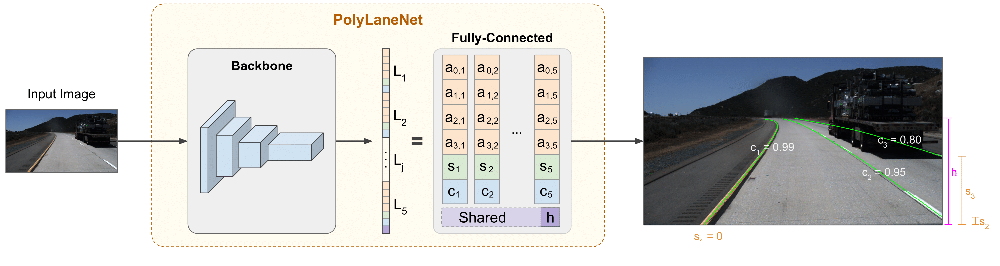

# Training

### Download sub-dataset

In [ ]:
!wget  https://s3.us-east-2.amazonaws.com/benchmark-frontend/datasets/1/train_set.zip

--2021-10-03 00:21:55--  https://s3.us-east-2.amazonaws.com/benchmark-frontend/datasets/1/train_set.zip
Resolving s3.us-east-2.amazonaws.com (s3.us-east-2.amazonaws.com)... 52.219.100.58
Connecting to s3.us-east-2.amazonaws.com (s3.us-east-2.amazonaws.com)|52.219.100.58|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11677439288 (11G) [application/zip]
Saving to: ‘train_set.zip’

train_set.zip       100%[===================>]  10.88G  42.3MB/s    in 4m 22s  

2021-10-03 00:26:18 (42.5 MB/s) - ‘train_set.zip’ saved [11677439288/11677439288]



In [ ]:
!unzip -qq /content/train_set.zip

### Import Libraries

In [ ]:
#@title library

import os
import sys
import random, math
import shutil
import logging
import argparse
import subprocess
from time import time
import cv2

project_path = "/content/" 
sys.path.append(project_path)
os.chdir(project_path)

import yaml
import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
mpl.rcParams['figure.figsize'] = (12,12)
import functools
import json

import tensorflow as tf
from tensorflow.keras import backend as K
import math
!pip install -U tensorflow-addons
import tensorflow_addons as tfa

from datetime import datetime


from tensorflow.python.client import device_lib
device_lib.list_local_devices()
print(f"Tensorflow ver. {tf.__version__}")

Tensorflow ver. 2.6.0


In [ ]:
#@markdown ## Hadware configuration:
try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver() # TPU detection
except ValueError:
  tpu = None
  gpus = tf.config.experimental.list_logical_devices("GPU")
    
# Select appropriate distribution strategy for hardware
if tpu:
  tf.config.experimental_connect_to_cluster(tpu)
  tf.tpu.experimental.initialize_tpu_system(tpu)
  strategy = tf.distribute.experimental.TPUStrategy(tpu)
  print('Running on TPU ', tpu.master())
  !nvidia-smi  
elif len(gpus) > 0:
  strategy = tf.distribute.MirroredStrategy(gpus) # this works for 1 to multiple GPUs
  print('Running on ', len(gpus), ' GPU(s) ')
  !nvidia-smi
else:
  strategy = tf.distribute.get_strategy() # default strategy that works on CPU and single GPU
  print('Running on CPU')

# How many accelerators do we have ?
print("Number of accelerators: ", strategy.num_replicas_in_sync)

MIXED_PRECISION = False #@param {type:"boolean"}
XLA_ACCELERATE  = True #@param {type:"boolean"}

if MIXED_PRECISION:
  #from tensorflow.keras.mixed_precision import experimental as mixed_precision
  from tensorflow.keras import mixed_precision
  if tpu: 
    policy = tf.keras.mixed_precision.experimental.Policy('mixed_bfloat16')
  else: 
    #policy = tf.keras.mixed_precision.experimental.Policy('mixed_float16')
    #mixed_precision.set_policy(policy)
    policy = mixed_precision.Policy('mixed_float16')
    mixed_precision.set_global_policy(policy)
    print('Mixed precision enabled')
    print('Compute dtype: %s' % policy.compute_dtype)
    print('Variable dtype: %s' % policy.variable_dtype)

if XLA_ACCELERATE:
    tf.config.optimizer.set_jit(True)
    print('Accelerated Linear Algebra enabled')

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
Running on  1  GPU(s) 
Sun Oct  3 01:22:12 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.74       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    36W / 250W |    347MiB / 16280MiB |      3%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------

###Define data paths

In [ ]:
root = "" #@param {type:"string"}

In [ ]:
#@title Create dataset functions
SPLIT_FILES = {
    'train+val': ['label_data_0313.json', 'label_data_0601.json', 'label_data_0531.json'],
    'train'    : ['label_data_0313.json', 'label_data_0601.json'],
    'val'      : ['label_data_0531.json'],
    'test'     : ['test_label.json']
    }
    
def convert2new_annos(key, path2files, files, max_lanes= None):

  def transform_anno(anno, max_lanes, max_points, img_hw=None):
    
    if img_hw is None:
      img_h, img_w = 720, 1280
    else:
      img_h, img_w = img_hw

    old_lanes  = anno['lanes'] 
    categories = anno['categories']  if 'categories' in anno else [1] * len(old_lanes)
    
    old_lanes  = zip(old_lanes, categories)
    old_lanes  = filter(lambda x: len(x[0]) > 0, old_lanes)

    lanes       = np.ones((max_lanes, 1 + 2  + 2 * max_points), dtype=np.float32) * -1e5
    lanes[:, 0] = 0
    old_lanes   = sorted(old_lanes, key=lambda x: x[0][0][0])

    for lane_pos, (lane, category) in enumerate(old_lanes):

      lower, upper = lane[0][1], lane[-1][1]
      
      xs = np.array([p[0] for p in lane]) / img_w
      ys = np.array([p[1] for p in lane]) / img_h
      
      #atleast 3 valid points needed
      if len(ys[xs>=0]) < 3:
        print(">>>remove lane with less than 3 points:", ys)
        continue
        
      lanes[lane_pos, 0] = category # confidence
      lanes[lane_pos, 1] = lower / img_h
      lanes[lane_pos, 2] = upper / img_h
      lanes[lane_pos, 3:3 + len(xs)] = np.flip(xs)
      lanes[lane_pos, (3 + max_points):(3 + max_points + len(ys))] = np.flip(ys)

    new_anno = {
        'path': anno['path'],
        'label': lanes,
        'old_anno': anno,
        'categories': [cat for _, cat in old_lanes]
    }

    return new_anno

  def load_annotations(anno_files):
    """
    [raw_file]: string type. the file path in the clip
    [lanes]: it is a list of list of lanes. 
    Each element in this list is x-coordinate of ground truth lane.
    [h_samples]: it is a list of height values corresponding to the lanes. 
    Each element in this list is y-coordinate of ground truth lane
    """
  
    annotations = []
    max_lanes   = 0
    max_points  = 0

    count_five_lanes   = 0
    count_four_lanes  = 0
    count_three_lanes = 0
    count_two_lanes   = 0
    count_one_lane    = 0

    for anno_file in anno_files:
      with open(anno_file, 'r') as anno_obj:
        lines = anno_obj.readlines()
        
        for line in lines:
            
          data = json.loads(line)
          y_samples = data['h_samples']
          gt_lanes = data['lanes']
            
          lanes = [[(x, y) for (x, y) in zip(lane, y_samples) if x >= 0] for lane in gt_lanes]
          lanes = [lane for lane in lanes if len(lane) > 0]
          
          #if len(lanes) !=4: continue
          if len(lanes) ==5:
            count_five_lanes +=1
          elif len(lanes) ==4:
            count_four_lanes +=1
          elif len(lanes) ==3:
            count_three_lanes +=1
          elif len(lanes) ==2:
            count_two_lanes +=1
          elif len(lanes) ==1:
            count_one_lane +=1  

          max_lanes = max(max_lanes, len(lanes))
          max_points = max(max_points, max([len(l) for l in gt_lanes]))

          annotations.append({
              'path': os.path.join(root, data['raw_file']),
              'org_path': data['raw_file'],
              'org_lanes': gt_lanes,
              'lanes': lanes,
              'aug': False,
              'y_samples': y_samples
          })

    print ("count_five_lanes",count_five_lanes)      
    print ("count_four_lanes",count_four_lanes)
    print ("count_three_lanes",count_three_lanes)
    print ("count_two_lanes",count_two_lanes)
    print ("count_one_lane",count_one_lane)

    return annotations, max_lanes, max_points
  
  anno_files       = [os.path.join(path2files, file) for file in files[key]]
  annos, mls, mps = load_annotations(anno_files)
  
  # Force max_lanes, used when evaluating testing with models trained on other datasets
  if max_lanes is not None:
    mls = max_lanes

  print(key)
  print('[TuSimple] ...total annos', len(annos))
  print('[TuSimple] ...max lanes', mls)
  print('[TuSimple] ...max points', mps)

  print('[LaneDataset] Transforming annotations...')
  
  N_annos = np.array([transform_anno(anno, max_lanes= mls, max_points= mps) for anno in annos])

  return N_annos, len(annos)

#### Set aside a validation split

In [ ]:
#@title cretate dataset
N_annos_train_val, num_train_val = convert2new_annos("train+val", root, SPLIT_FILES,max_lanes=5)

# Split our img paths into a training and a validation set
val_samples = round(num_train_val*0.1) #take 10% of the data for validation
random.Random(1337).shuffle(N_annos_train_val)
train = N_annos_train_val[:-val_samples]
val   = N_annos_train_val[-val_samples:]

N_annos_train, num_train = convert2new_annos("train", root, SPLIT_FILES)
N_annos_val, num_val     = convert2new_annos("val", root, SPLIT_FILES, max_lanes= 5)

count_five_lanes 239
count_four_lanes 2449
count_three_lanes 933
count_two_lanes 5
count_one_lane 0
train+val
[TuSimple] ...total annos 3626
[TuSimple] ...max lanes 5
[TuSimple] ...max points 56
[LaneDataset] Transforming annotations...
>>>remove lane with less than 3 points: [0.58333333]
>>>remove lane with less than 3 points: [0.36111111]
>>>remove lane with less than 3 points: [0.375]
>>>remove lane with less than 3 points: [0.36111111 0.375     ]
>>>remove lane with less than 3 points: [0.375      0.38888889]
>>>remove lane with less than 3 points: [0.375]
>>>remove lane with less than 3 points: [0.31944444 0.33333333]
>>>remove lane with less than 3 points: [0.36111111 0.375     ]
>>>remove lane with less than 3 points: [0.41666667]
>>>remove lane with less than 3 points: [0.27777778 0.29166667]
count_five_lanes 239
count_four_lanes 2404
count_three_lanes 621
count_two_lanes 4
count_one_lane 0
train
[TuSimple] ...total annos 3268
[TuSimple] ...max lanes 5
[TuSimple] ...max points 

In [ ]:
def lane_order_failed(lane_dataset, show_failed_sample= False):

  failed = list()
  for k, item in enumerate(lane_dataset):
    
    img   = item['path']
    label = item['label']
    
    PREX = 0
    PREY = 0
    PREY_list = []

    for i, lane in enumerate(label):
      if lane[0] == 0: continue # Skip invalid lanes
      
      lane = lane[3:] # remove conf, upper and lower positions
      xs = lane[:len(lane) // 2]
      ys = lane[len(lane) // 2:]
      ys = ys[xs > 0]   
      xs = xs[xs > 0]
      PREY_list.append(ys[0]) 
    
    PREY = min(PREY_list)
    for i, lane in enumerate(label):
      if lane[0] == 0: continue # Skip invalid lanes
      
      lane = lane[3:] # remove conf, upper and lower positions
      xs  = lane[:len(lane) // 2]
      ys  = lane[len(lane) // 2:]
      ys  = ys[xs > 0]   
      xs  = xs[xs > 0]
      nxs = xs[ys >= PREY]
      
      if PREX < nxs[len(nxs)-1]:
        PREX = nxs[len(nxs)-1]
      else:
        failed.append(k)

        if show_failed_sample:  
          print("k, i, PREX, PREY, PREY_list, xs, ys:", k, i, PREX, PREY, PREY_list, xs, ys)

          item = N_annos_train[k]
          img = draw_truelabel(item['path'], item['label'])
          display([img])
          break
        
  return failed

In [ ]:
def fix_lane_order_failed(lane_dataset):

  fixed_lane_dataset = lane_dataset

  for k, item in enumerate(lane_dataset):
    
    img   = item['path']
    label = item['label']
    failed = True
    while failed:
    
      PREX = 0
      PREY = 0
      PREY_list = []
      failed = False
      for i, lane in enumerate(label):
        if lane[0] == 0: continue # Skip invalid lanes
        
        lane = lane[3:] # remove conf, upper and lower positions
        xs = lane[:len(lane) // 2]
        ys = lane[len(lane) // 2:]
        ys = ys[xs > 0]   
        xs = xs[xs > 0]
        PREY_list.append(ys[0]) 
      
      PREY = min(PREY_list)
      for i, lane in enumerate(label):
        if lane[0] == 0: continue # Skip invalid lanes
        
        lane = lane[3:] # remove conf, upper and lower positions
        xs  = lane[:len(lane) // 2]
        ys  = lane[len(lane) // 2:]
        ys  = ys[xs > 0]   
        xs  = xs[xs > 0]
        nxs = xs[ys >= PREY]
        
        if PREX < nxs[len(nxs)-1]:
          PREX = nxs[len(nxs)-1]
        else:  
          if PREX == nxs[len(nxs)-1]:
            print("aaa")
            lane = np.ones((1, 1 + 2  + 2 * 56), dtype=np.float32) * -1e5
            lane[0] = 0
            label[i] = lane
            continue
          else:  
            # fix the position  
            failed = True
            label[i-1], label[i] = label[i], label[i-1].copy()

###Visualize

In [ ]:
#@title Display function

def display(display_list):
  
  plt.figure(figsize=(15, 15))

  title = ['True Lanes', 'Predicted Lanes']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    plt.imshow(display_list[i])
    #plt.imshow(display_list[i].astype('uint8'))
    plt.axis('off')
  plt.show()

def draw_truelabel(img, label, tf_tensor = False):

  if not tf_tensor:
    img = cv2.imread(img)
  else:
    # convert from tensor to nparray and remove first dimension
    img, label = img.numpy(), label.numpy() 
    print("Min and max pixel values:", img.min(), img.max())
  
  assert not isinstance(img,type(None)), 'image not found'
  img_h, img_w, _ = img.shape
  print("image size:", [img_h, img_w])

  for i, lane in enumerate(label):
    #print(lane)
    if lane[0] == 0: continue # Skip invalid lanes
    
    lane = lane[3:] # remove conf, upper and lower positions
    xs   = lane[:len(lane) // 2]
    ys   = lane[len(lane) // 2:]
    
    ys = ys[xs >= 0]   
    xs = xs[xs >= 0] 
    
    #print([xs, ys])

    # draw GT points
    size_point = 3
    if tf_tensor: size_point = 1 # we're going to cut-off half
    
    for p in zip(xs, ys):
      p   = (int(p[0] * img_w), int(p[1] * img_h))
      img = cv2.circle(img, p, size_point, color= (255, 0, 0), thickness= -1)
      
    # draw GT lane ID
    cv2.putText(img, "ID:"+ str(i), (int(xs[len(xs)//2] * img_w), int(ys[len(ys)//2] * img_h)),
                fontFace =cv2.FONT_HERSHEY_COMPLEX, fontScale=1, color=(0, 255, 0))
    
  return img
  
def draw_prediction(img, pred, tf_tensor = False, cls_pred = None):

  PRED_HIT_COLOR = (0, 255, 0)
  PRED_MISS_COLOR = (0, 0, 255)
  
  pred = pred[pred[:,0] != 0]  # filter invalid lanes
  
  if not tf_tensor:
    img = cv2.imread(img)
  else:
    # convert from tensor to nparray and remove first dimension
    img = img.numpy()
  
  overlay = img.copy()
  assert not isinstance(img,type(None)), 'image not found'
  img_h, img_w, _ = img.shape
  #print(img_h)
  #print(img_w) 
  for i, lane in enumerate(pred):
           
    #print(lane)
    color = PRED_MISS_COLOR
    lane = lane[1:]  # remove conf
    lower, upper= lane[0], lane[1]
    lane = lane[2:]  # remove upper, lower positions
    #print(lane)
    # generate points from the polynomial
    ys = np.linspace(lower, upper, num=100)
    xs = np.polyval(lane, ys)
    #print(i)
    
    points = np.zeros((len(ys), 2), dtype=np.int32)
    points[:, 1] = (ys * img_h).astype(int)
    points[:, 0] = (xs * img_w).astype(int)
    #print(points[1,:])
    
    # draw lane with a polyline on the overlay
    for current_point, next_point in zip(points[:-1], points[1:]):
      overlay = cv2.line(overlay, tuple(current_point), tuple(next_point), 
                         color=color, thickness=2)

    # draw class icon
    if cls_pred is not None and len(points) > 0:
      class_icon = self.dataset.get_class_icon(cls_pred[i])
      class_icon = cv2.resize(class_icon, (32, 32))
      mid = tuple(points[len(points) // 2] - 60)
      x, y = mid

      img[y:y + class_icon.shape[0], x:x + class_icon.shape[1]] = class_icon

    # draw lane ID
    if len(points) > 0:
      cv2.putText(img, str(i), tuple(points[0]), 
                  fontFace=cv2.FONT_HERSHEY_COMPLEX, fontScale=1, color=(0, 255, 0))

    # draw lane accuracy
      
    # Add lanes overlay
    w = 0.8
    #img = ((1. - w) * img + w * overlay).astype(np.uint8)

  return overlay

image size: [720, 1280]


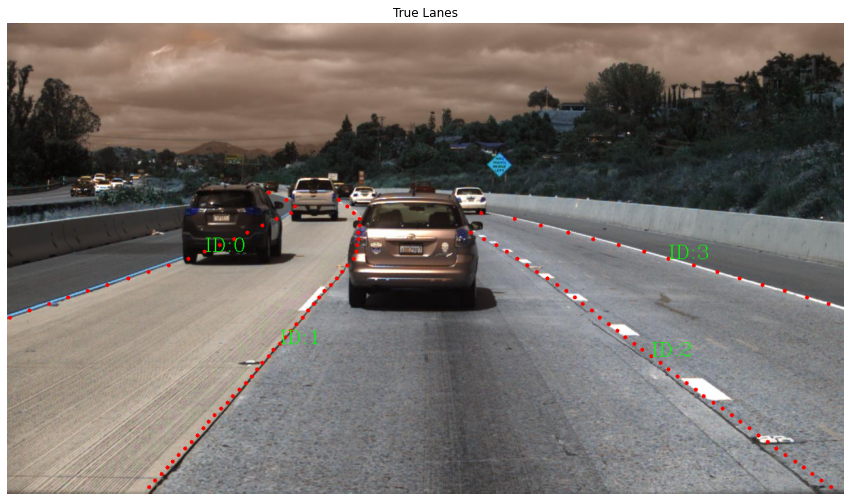

In [ ]:
display_num =  1#@param {type:"integer"}
r_choices   = np.random.choice(len(N_annos_train), display_num)

for item in N_annos_train[r_choices]:
  img = draw_truelabel(item['path'], item['label'])
  display([img])

In [ ]:
"""
Wrong order of lane: N_annos_train
[493, 902, 1005, 1027, 1119, 1437, 1583, 1982, 2698, 2730,
 2911, 2912, 2974, 3062, 3066, 3066, 3229, 3237, 3237]
"""
print("Before reorder, wrong order of lane")
print("train:", lane_order_failed(train, False))
print("val:", lane_order_failed(val, False))
print("N_annos_train:", lane_order_failed(N_annos_train, False))

fix_lane_order_failed(N_annos_train)
fix_lane_order_failed(train)
fix_lane_order_failed(val)

print("After reorder, wrong order of lane")
print("train:", lane_order_failed(train, False))
print("val:", lane_order_failed(val, False))
print("N_annos_train:", lane_order_failed(N_annos_train, False))

Before reorder, wrong order of lane
train: [65, 69, 101, 108, 108, 109, 109, 155, 172, 196, 209, 256, 329, 365, 402, 526, 550, 579, 636, 660, 663, 678, 691, 691, 735, 763, 766, 792, 867, 909, 919, 1006, 1037, 1057, 1084, 1115, 1142, 1201, 1208, 1254, 1280, 1299, 1386, 1405, 1409, 1474, 1555, 1561, 1598, 1611, 1640, 1647, 1705, 1872, 1917, 1927, 1929, 2006, 2039, 2044, 2078, 2097, 2111, 2145, 2165, 2217, 2235, 2253, 2312, 2397, 2403, 2417, 2444, 2449, 2500, 2500, 2527, 2534, 2587, 2603, 2648, 2669, 2696, 2698, 2716, 2753, 2784, 2881, 2976, 2986, 3009, 3119, 3170, 3186, 3188, 3233, 3258]
val: [23, 59, 62, 127, 133, 187, 249, 271, 271, 271, 299, 322]
N_annos_train: [24, 73, 99, 101, 266, 343, 394, 429, 445, 478, 493, 610, 644, 648, 754, 759, 844, 902, 987, 1005, 1027, 1057, 1119, 1143, 1185, 1263, 1437, 1453, 1502, 1534, 1583, 1586, 1672, 1672, 1779, 1804, 1840, 1863, 1982, 2194, 2305, 2384, 2524, 2534, 2537, 2615, 2615, 2623, 2698, 2730, 2882, 2886, 2901, 2911, 2912, 2974, 2978, 3012, 30

image size: [720, 1280]


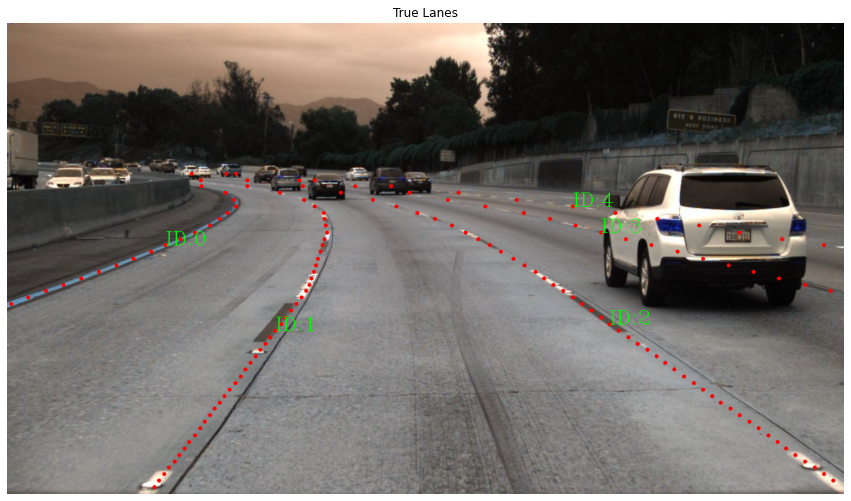

In [ ]:
item = val[271]
img = draw_truelabel(item['path'], item['label'])
display([img])

### Build input pipeline

In [ ]:
#@title Configure input pipline { display-mode: "form" }
#https://github.com/Ximilar-com/tf-image/tree/c3e91d6226c0891eaf6ca1c4271113d11b2e1dc6/tf_image/core/bboxes
#https://keras.io/examples/vision/retinanet/

img_shape = (360, 640, 3) #raw img_shape = (720, 1280, 3)

epochs =          2695#@param {type:"integer"}
distributed = False #@param {type:"boolean"}

if (distributed):
  if tpu: 
    batch_size = 16*strategy.num_replicas_in_sync  # A TPU has 8 cores so this will be 128
  else:
    batch_size = 32  # On Colab/GPU, a higher batch size does not help and sometimes does not fit on the GPU (OOM)
else:
  batch_size =      16#@param {type:"integer"}

In [ ]:
#@title Image Distortion
@tf.function(jit_compile=True)
def _add_gaussian_noise(image, stddev_max=0.3):
  
  stddev = tf.random.uniform([], 0.0, stddev_max)
  noise  = tf.random.normal(shape=tf.shape(image), mean=0, stddev=stddev)
  
  noise_prob = tf.random.uniform([], 0.0, 1.0)
  noise_img  = tf.cond(tf.less(noise_prob, 0.5),
                       lambda: image + noise, 
                       lambda: image)
  
  return noise_img

@tf.function(jit_compile=True)
def _swap_channel(image):
  indices = tf.range(start=0, limit=3, dtype=tf.int32)
  shuffled_indices = tf.random.shuffle(indices)

  swap_prob = tf.random.uniform([], 0.0, 1.0)
  swap_img  = tf.cond(tf.less(swap_prob, 0.7),
                  lambda: tf.gather(image, shuffled_indices, axis=2), 
                  lambda: image)
  
  return swap_img

@tf.function(jit_compile=True)
def _color_transform(img):

  img = tf.image.random_brightness(img,0.2)
  img = tf.image.random_contrast(img,0.6,1.4)
  img = tf.image.random_hue(img,0.07) 
  img = tf.image.random_saturation(img,0.5,1.5)
  return img

@tf.function(jit_compile=True)
def _distortions(image, distortions):

  distort_left_right_random = distortions[0]
  mirror = tf.less(tf.stack([1.0, distort_left_right_random, 1.0]), 0.5)
  image  = tf.reverse(image, tf.cast(mirror,tf.int32))
    
  distort_up_down_random = distortions[1]
  mirror = tf.less(tf.stack([distort_up_down_random, 1.0, 1.0]), 0.5)
  image  = tf.reverse(image, tf.cast(mirror,tf.int32))
    
  return image

@tf.function(jit_compile=True)
def image_distortions(image):
  distortions = tf.random.uniform([2], 0, 1.0, dtype=tf.float32)
  image = _distortions(image, distortions)

  return image

@tf.function(jit_compile=True)
def _apply_blur(img):

  #https://stackoverflow.com/questions/59286171/gaussian-blur-image-in-dataset-pipeline-in-tensorflow
  def _gaussian_kernel(kernel_size, sigma, n_channels, dtype):
    x = tf.range(-kernel_size // 2 + 1, kernel_size // 2 + 1, dtype=dtype)
    g = tf.math.exp(-(tf.pow(x, 2) / (2 * tf.pow(tf.cast(sigma, dtype), 2))))
    g_norm2d = tf.pow(tf.reduce_sum(g), 2)
    g_kernel = tf.tensordot(g, g, axes=0) / g_norm2d
    g_kernel = tf.expand_dims(g_kernel, axis=-1)
    return tf.expand_dims(tf.tile(g_kernel, (1, 1, n_channels)), axis=-1)

  blur = _gaussian_kernel(3, 2, 3, img.dtype)
  img = tf.nn.depthwise_conv2d(img[None], blur, [1,1,1,1], 'SAME')
  return img[0]

@tf.function(jit_compile=True)
def gaussian_blur(img, ksize=5, sigma=1):

  def gaussian_kernel(size=3, sigma=1):
    x_range = tf.range(-(size-1)//2, (size-1)//2 + 1, 1)
    y_range = tf.range((size-1)//2, -(size-1)//2 - 1, -1)

    xs, ys = tf.meshgrid(x_range, y_range)        
    kernel = tf.exp(-(xs**2 + ys**2)/(2*(sigma**2))) / (2*np.pi*(sigma**2))
    return tf.cast( kernel / tf.reduce_sum(kernel), tf.float32)
    
  kernel = gaussian_kernel(ksize, sigma)
  kernel = tf.expand_dims(tf.expand_dims(kernel, axis=-1), axis=-1)
    
  r, g, b = tf.split(img, [1,1,1], axis=-1)
  r_blur = tf.nn.conv2d([r], kernel, [1,1,1,1], 'SAME')
  g_blur = tf.nn.conv2d([g], kernel, [1,1,1,1], 'SAME')
  b_blur = tf.nn.conv2d([b], kernel, [1,1,1,1], 'SAME')

  blur_image = tf.concat([r_blur, g_blur, b_blur], axis=-1)
  return tf.squeeze(blur_image, axis=0)

@tf.function(jit_compile=True)
def _distore_img(img):
  prob = tf.random.uniform([], 0.0, 1.0)
  img  = tf.cond(tf.less(prob, 0.4), 
                   lambda: _add_gaussian_noise(img), 
                   lambda: _apply_blur(img))
  return img

In [ ]:
#@title Blackout
#https://www.kaggle.com/aziz69/efficientnets-meta-data-augs-0-939-public-lb

@tf.function
def transform_random_blackout(img, sl=0.1, sh=0.2, rl=0.4):
  
  h, w, c = tf.shape(img)[-3], tf.shape(img)[-2], 3
  origin_area = tf.cast(h*w, tf.float32)

  e_size_l = tf.cast(tf.round(tf.sqrt(origin_area * sl * rl)), tf.int32)
  e_size_h = tf.cast(tf.round(tf.sqrt(origin_area * sh / rl)), tf.int32)

  e_height_h = tf.minimum(e_size_h, h)
  e_width_h  = tf.minimum(e_size_h, w)

  erase_height = tf.random.uniform(shape=[], minval=e_size_l, maxval=e_height_h, dtype=tf.int32)
  erase_width  = tf.random.uniform(shape=[], minval=e_size_l, maxval=e_width_h, dtype=tf.int32)

  erase_area = tf.zeros(shape=[erase_height, erase_width, c])
  erase_area = tf.cast(erase_area, tf.uint8)

  pad_h = h - erase_height
  pad_top    = tf.random.uniform(shape=[], minval=0, maxval=pad_h, dtype=tf.int32)
  pad_bottom = pad_h - pad_top

  pad_w = w - erase_width
  pad_left  = tf.random.uniform(shape=[], minval=0, maxval=pad_w, dtype=tf.int32)
  pad_right = pad_w - pad_left

  erase_mask = tf.pad([erase_area], [[0,0],[pad_top, pad_bottom], [pad_left, pad_right], [0,0]], constant_values=1)
  erase_mask = tf.squeeze(erase_mask, axis=0)
  erased_img = tf.multiply(tf.cast(img,tf.float32), tf.cast(erase_mask, tf.float32))

  return tf.cast(erased_img, img.dtype)


In [ ]:
#@title GridMask
#https://www.kaggle.com/aziz69/efficientnets-meta-data-augs-0-939-public-lb

@tf.function
def transformV(image, inv_mat, image_shape):

  h, w, c = image_shape
  cx, cy = w//2, h//2
  
  new_xs = tf.repeat( tf.range(-cx, cx, 1), h)
  new_ys = tf.tile( tf.range(-cy, cy, 1), [w])
  new_zs = tf.ones([h*w], dtype=tf.int32)
  
  old_coords = tf.matmul(inv_mat, tf.cast(tf.stack([new_xs, new_ys, new_zs]), tf.float32))
  old_coords_x = tf.round(old_coords[0, :] + tf.cast(w//2,tf.float32))
  old_coords_y = tf.round(old_coords[1, :] + tf.cast(h//2,tf.float32))
  
  old_coords_x = tf.cast(old_coords_x, tf.int32)
  old_coords_y = tf.cast(old_coords_y, tf.int32)

  clip_mask_x = tf.logical_or(old_coords_x< 0, old_coords_x> w-1)
  clip_mask_y = tf.logical_or(old_coords_y< 0, old_coords_y> h-1)
  clip_mask   = tf.logical_or(clip_mask_x, clip_mask_y)
  
  old_coords_x = tf.boolean_mask(old_coords_x, tf.logical_not(clip_mask))
  old_coords_y = tf.boolean_mask(old_coords_y, tf.logical_not(clip_mask))
    
  new_coords_x = tf.boolean_mask(new_xs+cx, tf.logical_not(clip_mask))
  new_coords_y = tf.boolean_mask(new_ys+cy, tf.logical_not(clip_mask))
  
  old_coords = tf.cast(tf.stack([old_coords_y, old_coords_x]), tf.int32)
  new_coords = tf.cast(tf.stack([new_coords_y, new_coords_x]), tf.int64)
  
  rotated_image_values  = tf.gather_nd(image, tf.transpose(old_coords))
  rotated_image_channel = list()

  for i in range(c):
    vals = rotated_image_values[:,i]
    sparse_channel = tf.SparseTensor(tf.transpose(new_coords), vals, [h, w])
    rotated_image_channel.append(tf.sparse.to_dense(sparse_channel, default_value=0, validate_indices=False))

  return tf.transpose(tf.stack(rotated_image_channel), [1,2,0])

@tf.function
def random_rotate(image, angle, image_shape):

  @tf.function(jit_compile=True)
  def get_rotation_mat_inv(angle):
    # transform to radian
    angle = math.pi * angle / 180
    cos_val = tf.math.cos(angle)
    sin_val = tf.math.sin(angle)
    one  = tf.constant([1], tf.float32)
    zero = tf.constant([0], tf.float32)
    rot_mat_inv = tf.concat([cos_val ,sin_val,zero,
                             -sin_val,cos_val,zero,
                             zero    ,zero   ,one ],axis=0)
    rot_mat_inv = tf.reshape(rot_mat_inv, [3,3])
    return rot_mat_inv
  
  angle       = float(angle) * tf.random.normal([1],dtype='float32')
  rot_mat_inv = get_rotation_mat_inv(angle)

  return transformV(image, rot_mat_inv, image_shape)

@tf.function
def apply_grid_mask(image):
  
  AugParams = {
      'd1' : 140,
      'd2': 160,
      'rotate' : 45,
      'ratio' : 0.3
      }
    
  h, w, c = tf.shape(image)[-3], tf.shape(image)[-2], 3
  
  @tf.function
  def GridMask(d1, d2, rotate_angle=1, ratio=0.5):
  
    hh = tf.cast(tf.math.ceil(tf.math.sqrt(tf.cast(h*h+w*w,tf.float32))),tf.int32) 
    hh = hh+1 if hh%2==1 else hh

    d = tf.random.uniform(shape=[], minval=d1, maxval=d2, dtype=tf.int32)
    l = tf.cast(tf.cast(d,tf.float32)*ratio+0.5, tf.int32)

    st_h = tf.random.uniform(shape=[], minval=0, maxval=d, dtype=tf.int32)
    st_w = tf.random.uniform(shape=[], minval=0, maxval=d, dtype=tf.int32)

    y_ranges = tf.range(-1 * d + st_h, -1 * d + st_h + l)
    x_ranges = tf.range(-1 * d + st_w, -1 * d + st_w + l)

    for i in range(0, hh//d+1):
      s1 = i * d + st_h
      s2 = i * d + st_w
      y_ranges = tf.concat([y_ranges, tf.range(s1,s1+l)], axis=0)
      x_ranges = tf.concat([x_ranges, tf.range(s2,s2+l)], axis=0)

    x_clip_mask = tf.logical_or(x_ranges < 0 , x_ranges > hh-1)
    y_clip_mask = tf.logical_or(y_ranges < 0 , y_ranges > hh-1)
    clip_mask = tf.logical_or(x_clip_mask, y_clip_mask)

    x_ranges = tf.boolean_mask(x_ranges, tf.logical_not(clip_mask))
    y_ranges = tf.boolean_mask(y_ranges, tf.logical_not(clip_mask))

    hh_ranges = tf.tile(tf.range(0,hh), [tf.cast(tf.reduce_sum(tf.ones_like(x_ranges)), tf.int32)])
    x_ranges = tf.repeat(x_ranges, hh)
    y_ranges = tf.repeat(y_ranges, hh)

    y_hh_indices = tf.transpose(tf.stack([y_ranges, hh_ranges]))
    x_hh_indices = tf.transpose(tf.stack([hh_ranges, x_ranges]))
    y_mask_sparse = tf.SparseTensor(tf.cast(y_hh_indices, tf.int64),  tf.zeros_like(y_ranges), [hh, hh])
    y_mask = tf.sparse.to_dense(y_mask_sparse, 1, False)

    x_mask_sparse = tf.SparseTensor(tf.cast(x_hh_indices, tf.int64), tf.zeros_like(x_ranges), [hh, hh])
    x_mask = tf.sparse.to_dense(x_mask_sparse, 1, False)

    mask = tf.expand_dims( tf.clip_by_value(x_mask + y_mask, 0, 1), axis=-1)

    mask = random_rotate(mask, rotate_angle, [hh, hh, 1])
    mask = tf.image.crop_to_bounding_box(mask, (hh-h)//2, (hh-w)//2, h, w)
    return mask
  
  mask = GridMask(AugParams['d1'], AugParams['d2'], AugParams['rotate'], AugParams['ratio'])
  
  if c == 3:
    mask = tf.concat([mask, mask, mask], axis=-1)
    mask = tf.cast(mask,tf.uint8)
      
  return image * mask

@tf.function 
def gridmask_blackout(img):
  prob = tf.random.uniform([], 0.0, 1.0)
  img  = tf.cond(tf.less(prob, 0.05), 
                 lambda: transform_random_blackout(img), 
                 lambda: apply_grid_mask(img))
  return img

#### Matrix transform

In [ ]:
@tf.function(jit_compile=True)
def matrix_creator(matrix_value):
  return tf.reshape(tf.concat(matrix_value,axis=0),[3,3])

@tf.function(jit_compile=True)
def _get_mat(rot,shr,h_zoom,w_zoom,h_shift,w_shift,do_hflip=True):
  """
  returns 3x3 transformmatrix which transforms indicies
  """
  one  = tf.constant([1],dtype='float32')
  zero = tf.constant([0],dtype='float32')
  # CONVERT DEGREES TO RADIANS
  rot   = math.pi * rot / 180.
  shear = math.pi * shr / 180.
  # ROTATION MATRIX
  c1 = tf.math.cos(rot)
  s1 = tf.math.sin(rot)
  
  # SHEAR MATRIX
  c2 = tf.math.cos(shear)
  s2 = tf.math.sin(shear)
  
  # MATRIX 
  hflip     = matrix_creator([-one,zero,zero,zero,one,zero,zero,zero,one])
  rotation = matrix_creator([c1,s1,zero,-s1,c1,zero,zero,zero,one])
  shear    = matrix_creator([one,s2,zero,zero,c2,zero,zero,zero,one])
  shift    = matrix_creator([one,zero,w_shift,zero,one,h_shift,zero,zero,one])
  zoom     = matrix_creator([h_zoom,zero,zero,zero,w_zoom,zero,zero,zero,one])  
  
  if do_hflip:
    mat = [rotation, shear, shift, zoom, hflip]
  else:
    mat = [rotation, shear, shift, zoom]
  random.Random(1337).shuffle(mat)
  
  transform = mat[0]
  for i in range(1, len(mat)):
    transform = K.dot(transform, mat[i])
  return transform

@tf.function(jit_compile=True)
def _transform_matrix_offset_center(matrix, img):

  one = tf.constant([1],dtype='float32')
  zero = tf.constant([0],dtype='float32')
  img_shape    = tf.cast(tf.shape(img), tf.float32)
  img_h, img_w = tf.reshape(img_shape[0],[1]), tf.reshape(img_shape[1],[1])

  o_x = (img_w - 1) / 2.0
  o_y = (img_h - 1) / 2.0
  
  offset_matrix = matrix_creator([one,zero,o_x, zero,one,o_y, zero,zero,one])
  reset_matrix  = matrix_creator([one,zero,-o_x, zero,one,-o_y, zero,zero,one])
  trans_matrix  = K.dot(K.dot(offset_matrix,matrix),reset_matrix)  

  return trans_matrix

@tf.function(jit_compile=True)
def _transform_matrix(rot_ang,shear_ang,zoom,shift,flip):

  rot     = rot_ang * tf.random.normal([1],dtype='float32')
  shr     = shear_ang * tf.random.normal([1],dtype='float32') 
  h_zoom  = zoom[0] + tf.random.normal([1],dtype='float32')/10 
  w_zoom  = zoom[1] + tf.random.normal([1],dtype='float32')/10
  h_shift = shift[0] * tf.random.normal([1],dtype='float32') 
  w_shift = shift[1] * tf.random.normal([1],dtype='float32')

  # GET TRANSFORMATION MATRIX
  mat = _get_mat(rot,shr,h_zoom,w_zoom,h_shift,w_shift,flip)

  return mat

In [ ]:
@tf.function
def _tf_transformImg(image,forward_transform, DIM = (720,1280)):

  if DIM[0]!=DIM[1]:
    pad = (DIM[1]-DIM[0])//2
    image = tf.pad(image, [[0, 0], [pad, pad+1],[0, 0]])
        
  NEW_DIM = DIM[0]
  XDIM = NEW_DIM%2
    
  # LIST DESTINATION PIXEL INDICES
  x   = tf.repeat(tf.range(NEW_DIM//2, -NEW_DIM//2,-1), NEW_DIM)
  y   = tf.tile(tf.range(-NEW_DIM//2, NEW_DIM//2), [NEW_DIM])
  z   = tf.ones([NEW_DIM*NEW_DIM], dtype='int32')
  idx = tf.stack( [x,y,z] )
    
  # ROTATE DESTINATION PIXELS ONTO ORIGIN PIXELS
  idx2 = K.dot(forward_transform, tf.cast(idx, dtype='float32'))
  idx2 = K.cast(idx2, dtype='int32')
  idx2 = K.clip(idx2, -NEW_DIM//2+XDIM+1, NEW_DIM//2)
    
  # FIND ORIGIN PIXEL VALUES           
  idx3 = tf.stack([NEW_DIM//2-idx2[0,], NEW_DIM//2-1+idx2[1,]])
  d    = tf.gather_nd(image, tf.transpose(idx3))
    
  if DIM[0]!=DIM[1]:
    image = tf.reshape(d,[NEW_DIM, NEW_DIM,3])
    image = image[:, pad:DIM[1]+pad,:]
  
  image = tf.reshape(image, [*DIM, 3])

  return image

@tf.function
def _transformImg(imgIn,forward_transform):
  @tf.function(jit_compile=True)
  def flat_transforms(transform_matrices):
    # Flatten each matrix.
    transforms = tf.reshape(transform_matrices, tf.constant([-1, 9]))
    # Divide each matrix by the last entry (normally 1).
    transforms /= transforms[:, 8:9]
    return transforms[:, :8]

  t = flat_transforms(tf.linalg.inv(forward_transform))
  imgOut = tfa.image.transform(imgIn, t, interpolation="BILINEAR",name=None)

  return imgOut

In [ ]:
@tf.function
def _transformLabel(label,forward_transform,img_shape, flip=True):

  @tf.function(jit_compile=True)
  def point_transform(X,Y,matrix):
    point = tf.matmul(matrix,tf.constant([X,Y,1],shape=[3,1],dtype=tf.float32))
    return point
  
  @tf.function(jit_compile=True)
  def X_trasnform(X,Y,matrix):
    #Collecting elements from a tensor 
    matrix_element = tf.gather_nd(matrix, [[0,0],[0,1],[0,2]])
    return matrix_element[0]*X + matrix_element[1]*Y + matrix_element[2]
  
  @tf.function(jit_compile=True)
  def Y_trasnform(X,Y,matrix):
    #Collecting elements from a tensor 
    matrix_element = tf.gather_nd(matrix, [[1,0],[1,1],[1,2]])
    return matrix_element[0]*X + matrix_element[1]*Y + matrix_element[2]
  
  img_h,img_w = img_shape[0],img_shape[1]
  # Gardering all elements
  conf   = tf.reshape(label[:,0], [-1,1])
  lanes  = label[:,3:]
  xs     = lanes[:, :lanes.shape[1] // 2]
  ys     = lanes[:, lanes.shape[1] // 2:]
  
  # Transforming X,Y
  newxs  = X_trasnform(xs*img_w,ys*img_h,forward_transform)
  newys  = Y_trasnform(xs*img_w,ys*img_h,forward_transform)
  
  # Removing all invalid X,Y
  invalididx = tf.logical_or(tf.logical_or(tf.less(newxs, 0),tf.less(newys, 0)),
                             tf.logical_or(tf.greater(newxs, img_w),tf.greater(newys, img_h)))
  
  newxs = tf.where(invalididx, -1e5, newxs/img_w)
  newys = tf.where(invalididx, -1e5, newys/img_h)
  
  lower = tf.reshape(tf.reduce_min(tf.where(tf.equal(newys, -1e5),1e5,newys),axis=[1]),[-1,1])
  lower = tf.where(tf.equal(lower,1e5), -1e5,lower)

  upper = tf.reshape(tf.reduce_max(newys,axis=[1]),[-1,1])
  
  validlane = tf.logical_and(tf.not_equal(lower, -1e5),tf.not_equal(upper, -1e5))
  validlane = tf.logical_and(validlane,tf.not_equal(conf, 0))
  conf = tf.cast(validlane, tf.float32)
  
  LabelOut = tf.concat([conf,lower,upper,newxs,newys],-1)
  if flip:
    #we just want to flip valid lanes, and keep everything in order
    validlabel   = tf.boolean_mask(LabelOut,tf.greater(tf.reshape(LabelOut[:, 0],[-1]),0))
    invalidlabel = tf.boolean_mask(LabelOut,tf.less(tf.reshape(LabelOut[:, 0],[-1]),1))
      
    #horizontally flipped
    validlabel = tf.reverse(validlabel, [0])
    LabelOut   = tf.concat([validlabel,invalidlabel],0)
  
  return LabelOut

In [ ]:
@tf.function
def _transform2center(img,label,rotation_ang,shear_ang,zoom,shift,flip):

  mat  = _transform_matrix(rotation_ang,shear_ang,zoom,shift,flip)
  mat  = _transform_matrix_offset_center(mat,img)
  # Transform the image using a single operation
  img   = _transformImg(img, mat)
  # Transform the label using a single operation
  label  = _transformLabel(label,mat,tf.cast(tf.shape(img),tf.float32),flip)
  
  return img, label

@tf.function
def _transform(img,label,rotation_ang,shear_ang,zoom,shift,flip):
  var  = (img,label,rotation_ang,shear_ang,zoom,shift,flip)
  return _transform2center(*var)

In [ ]:
#@title
@tf.function
def _transform2center_old(img,label,rotation_ang,shear_ang,zoom,shift,flip):

  prob = tf.random.uniform([], 0.0, 1.0)
  
  mat  = tf.cond(tf.less(prob, 0.5),
                 lambda: _transform_matrix(rotation_ang,shear_ang,zoom,shift,flip),
                 lambda: _transform_matrix(rotation_ang,shear_ang,zoom,shift,flip=False))

  mat  = _transform_matrix_offset_center(mat,img)
  
  # Transform the image using a single operation
  img   = _transformImg(img, mat)
  # Transform the label using a single operation
  
  label  = tf.cond(tf.less(prob, 0.5), 
                    lambda: _transformLabel(label,mat,tf.cast(tf.shape(img),tf.float32)), 
                    lambda: _transformLabel(label,mat,tf.cast(tf.shape(img),tf.float32),flip=False))
  
  return img, label

@tf.function
def _transform2edge(img,label,rotation_ang,shear_ang,zoom,shift,flip):

  mat  = _transform_matrix(rotation_ang,shear_ang,zoom,shift,flip=False)
  # Transform the image using a single operation
  img   = _transformImg(img, mat)
  # Transform the label using a single operation
  label  = _transformLabel(label,mat,tf.cast(tf.shape(img),tf.float32),flip=False)
  
  return img, label

@tf.function
def _transform_old(img,label,rotation_ang,shear_ang,zoom,shift,flip):
  
  prob = tf.random.uniform([], 0.0, 1.0)
  var  = (img,label,rotation_ang,shear_ang,zoom,shift,flip)

  img, label  = tf.cond(tf.less(prob, 0.9), 
                        lambda: _transform2center(*var), 
                        lambda: _transform2edge(*var))
  
  return img, label

@tf.function
def _transformLabel_old(label,forward_transform,img_shape, flip=True):

  @tf.function(jit_compile=True)
  def point_transform(X,Y,matrix):
    point = tf.matmul(matrix,tf.constant([X,Y,1],shape=[3,1],dtype=tf.float32))
    return point
  
  @tf.function(jit_compile=True)
  def X_trasnform(X,Y,matrix):
    #Collecting elements from a tensor 
    matrix_element = tf.gather_nd(matrix, [[0,0],[0,1],[0,2]])
    return matrix_element[0]*X + matrix_element[1]*Y + matrix_element[2]
  
  @tf.function(jit_compile=True)
  def Y_trasnform(X,Y,matrix):
    #Collecting elements from a tensor 
    matrix_element = tf.gather_nd(matrix, [[1,0],[1,1],[1,2]])
    return matrix_element[0]*X + matrix_element[1]*Y + matrix_element[2]
  
  img_h,img_w = img_shape[0],img_shape[1]
  # Gardering all elements
  conf   = tf.reshape(label[:,0], [-1,1])
  lanes  = label[:,3:]
  xs     = lanes[:, :lanes.shape[1] // 2]
  ys     = lanes[:, lanes.shape[1] // 2:]
  
  # Transforming X,Y
  newxs  = tf.where(tf.equal(xs,-1e5),-1e5, X_trasnform(xs*img_w,ys*img_h,forward_transform)/img_w)
  newys  = tf.where(tf.equal(ys,-1e5),-1e5, Y_trasnform(xs*img_w,ys*img_h,forward_transform)/img_h)
  
  # Removing all invalid X,Y
  invalididx = tf.logical_or(tf.logical_or(tf.less(newxs, 0),tf.greater(newxs, 1)),
                             tf.logical_or(tf.less(newys, 0),tf.greater(newys, 1)))
  newxs = tf.where(invalididx, -1e5,newxs)
  newys = tf.where(invalididx, -1e5,newys)
  
  lower = tf.reshape(tf.reduce_min(tf.where(tf.equal(newys, -1e5),1e5,newys),axis=[1]),[-1,1])
  lower = tf.where(tf.equal(lower,1e5), -1e5,lower)

  upper = tf.reshape(tf.reduce_max(newys,axis=[1]),[-1,1])
  
  validlane = tf.logical_and(tf.not_equal(lower, -1e5),tf.not_equal(upper, -1e5))
  validlane = tf.logical_and(validlane,tf.not_equal(conf, 0))
  conf = tf.cast(validlane, tf.float32)
  
  """
  tf.print("\n[conf,lower,upper,lowerxs,upperys, newxs,newys]:\n",
           [conf,lower,upper,lowerxs,upperxs,newxs,newys],
           output_stream=sys.stdout) 
  LabelOut = tf.concat([conf,lower,upper,xs_lower,xs_upper,newxs,newys],-1)
  """
  LabelOut = tf.concat([conf,lower,upper,newxs,newys],-1)
  if flip:
    #we just want to flip valid lanes, and keep everything in order
    validlabel   = tf.boolean_mask(LabelOut,tf.equal(tf.reshape(LabelOut[:, 0],[-1]),1))
    invalidlabel = tf.boolean_mask(LabelOut,tf.not_equal(tf.reshape(LabelOut[:, 0],[-1]),1))
      
    #horizontally flipped
    validlabel = tf.reverse(validlabel, [0])
    LabelOut   = tf.concat([validlabel,invalidlabel],0)
  
  #tf.print("\n[Label:\n",[LabelOut],output_stream=sys.stdout)

  return LabelOut

#### Agumentation

In [ ]:
@tf.function
def _resize(img,label, newsize):
  newimg = tf.image.resize(img, newsize)
  
  return newimg, label

@tf.function
def _process_files(path2file, label):
  
  # We map this function onto each pathname pair  
  img_str = tf.io.read_file(path2file)
  img     = tf.image.decode_jpeg(img_str, channels=3)
  
  return img, label
  
@tf.function
def _tf_augment(img,label,resize=None,scale=1,color_transform=None,swap_channel=None,
                gaussian_noise=None,blackout=None,rotation_ang=None,shear_ang=None,
                zoom=None,shift=None,flip=None):        
      
  if color_transform:
    img = _color_transform(img) 
        
  if swap_channel: 
    img = _swap_channel(img)

  if rotation_ang or shear_ang or zoom or shift or flip is not None:
    prob = tf.random.uniform([], 0.0, 1.0)
    img,label = tf.cond(tf.less(prob, 0.9), 
                        lambda: _transform(img,label,rotation_ang,shear_ang,zoom,shift,flip), 
                        lambda: (gridmask_blackout(img),label))
    
  #This will convert to float values in [0, 1]
  img = tf.image.convert_image_dtype(img, tf.float32)
  #img = tf.cast(img, tf.float32)*scale
  
  if gaussian_noise: 
    prob = tf.random.uniform([], 0.0, 1.0)
    img  = tf.cond(tf.less(prob, 0.3), 
                   lambda: _distore_img(img), 
                   lambda: img)
    
  #Make sure the image is still in [0, 1]  
  img = tf.clip_by_value(img, 0., 1.)
  if resize is not None:  
    img,label = _resize(img,label,resize) 

  return img, label

In [ ]:
def get_dataset(annos,preproc_fn =functools.partial(_tf_augment),threads=tf.data.AUTOTUNE, 
                batch_size=batch_size,shuffle=True,cache=False):           
  
  num_x = len(annos)

  imgs   =[]
  labels =[]
  for item in annos:
    imgs.append(item['path'])
    labels.append(item['label'])
  
  # Create a dataset from the filenames and labels
  dataset = tf.data.Dataset.from_tensor_slices((imgs,labels))
  
  # Set the option
  option_no_order = tf.data.Options()
  option_no_order.experimental_deterministic = False # to allow order-altering optimizations.
  option_no_order.threading.max_intra_op_parallelism = 1 #disabling intra-op parallelism
  dataset = dataset.with_options(option_no_order)

  if shuffle:
    dataset = dataset.shuffle(num_x, reshuffle_each_iteration=True) 
  
  # Map our preprocessing function to every element in our dataset, taking
  # advantage of multithreading
  dataset = dataset.map(_process_files,num_parallel_calls=threads)
  
  # small dataset, only load it once, and keep it in memory.
  # big dataset, use `.cache(filename)` to cache preprocessing work for datasets that don't
  # fit in memory.
  if cache:
    if isinstance(cache, str): 
      dataset = dataset.cache(cache)
    else: 
      dataset = dataset.cache()

  dataset = dataset.map(preproc_fn,num_parallel_calls=threads)
  """
  if shuffle:
    dataset = dataset.shuffle(num_x//8, reshuffle_each_iteration=True) 
  """
  # It's necessary to repeat our data for all epochs 
  dataset = dataset.repeat()
  
  # Vectorize your mapped function
  dataset = dataset.batch(batch_size, drop_remainder=True)
  
  # threads: Overlap producer and consumer works/ -1: autotune prefetch buffer size
  #dataset = dataset.prefetch(-1) 
  
  #prefetch_to_device
  #dataset = dataset.apply(tf.data.experimental.prefetch_to_device('/gpu:0', buffer_size=threads))
  
  #copy_to_device
  dataset = dataset.apply(tf.data.experimental.copy_to_device("/gpu:0"))
  with tf.device("/gpu:0"):
    dataset = dataset.prefetch(1)
  
  return dataset

In [ ]:
#Create train datastore and validation datastore
tr_cfg = {'resize': [img_shape[0], img_shape[1]],
          'scale':1/255.0,
          'color_transform':False, 
          'swap_channel':False,
          'blackout':True,
          'gaussian_noise':False,
          'rotation_ang':10., #deg
          'shear_ang': 7.,
          'zoom':(1.8,1.8),
          'shift':(30.,30.),
          'flip': True}
val_cfg = {'resize': [img_shape[0], img_shape[1]],
           'scale':1/255.0,}

tr_preprocessing_fn  = functools.partial(_tf_augment, **tr_cfg)
val_preprocessing_fn = functools.partial(_tf_augment, **val_cfg)

trainds = get_dataset(train,preproc_fn=tr_preprocessing_fn,
                      batch_size=batch_size,cache='./') #../../LANE_DETECTION/
valds   = get_dataset(val,preproc_fn=val_preprocessing_fn,
                       batch_size=batch_size,shuffle=False)

#### Sample augmented data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


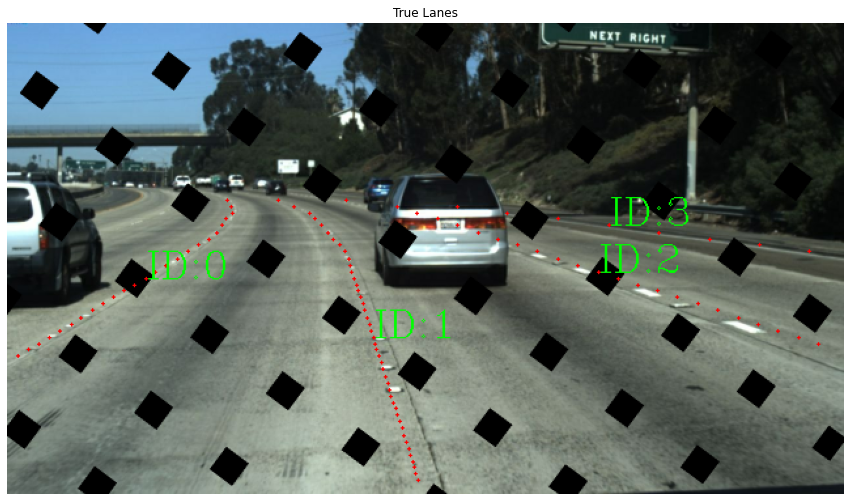

Min and max pixel values: 0.019607846 1.0
image size: [360, 640]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


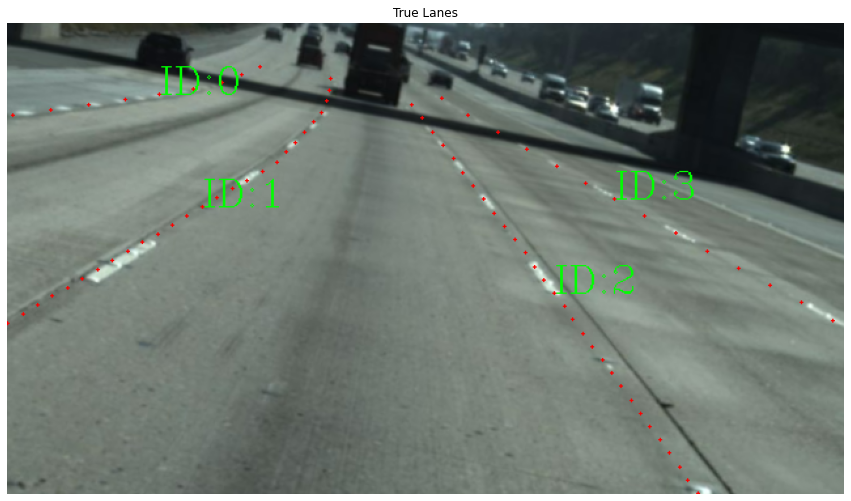

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.009803923 1.0
image size: [360, 640]


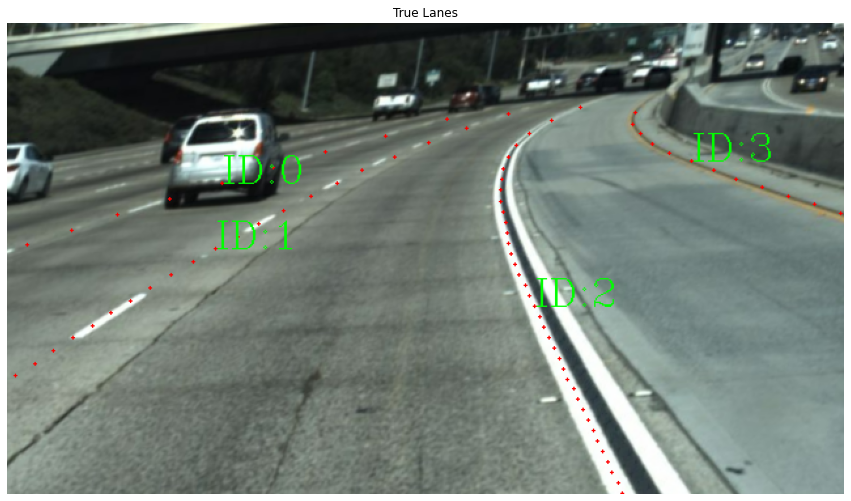

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.003921569 1.0
image size: [360, 640]


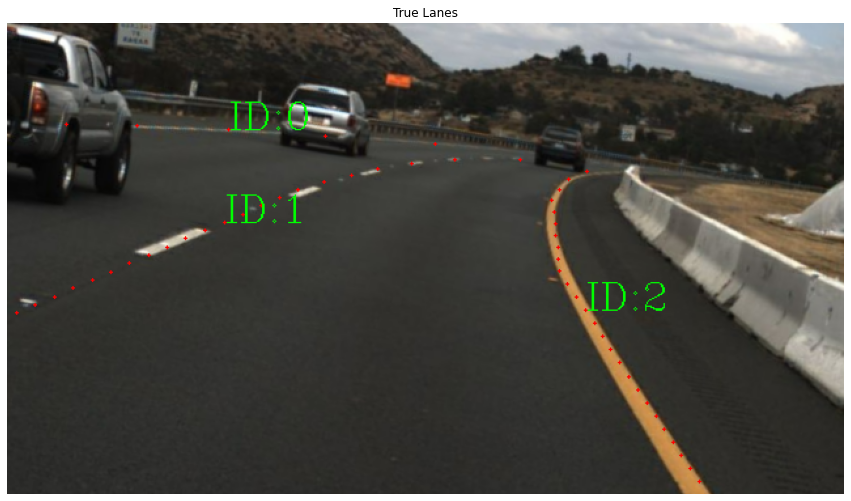

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


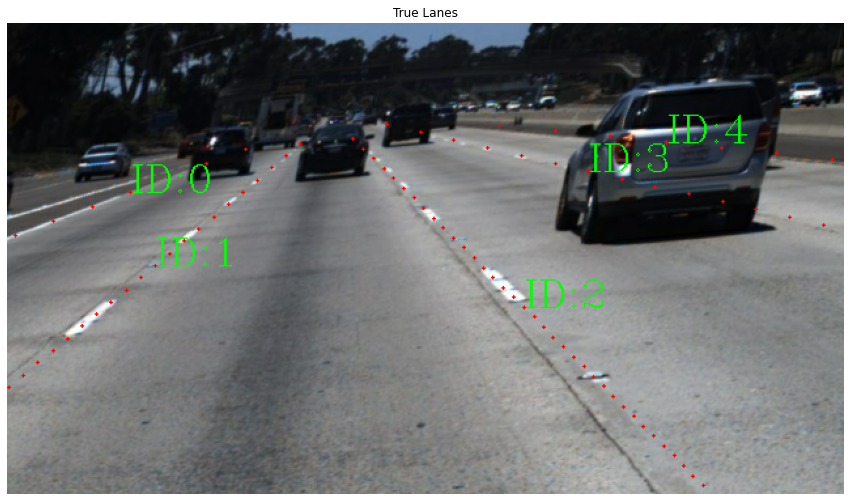

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


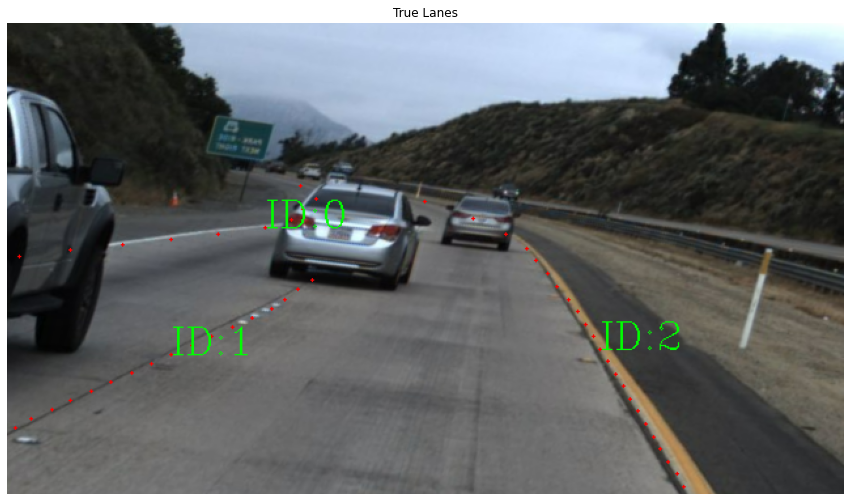

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


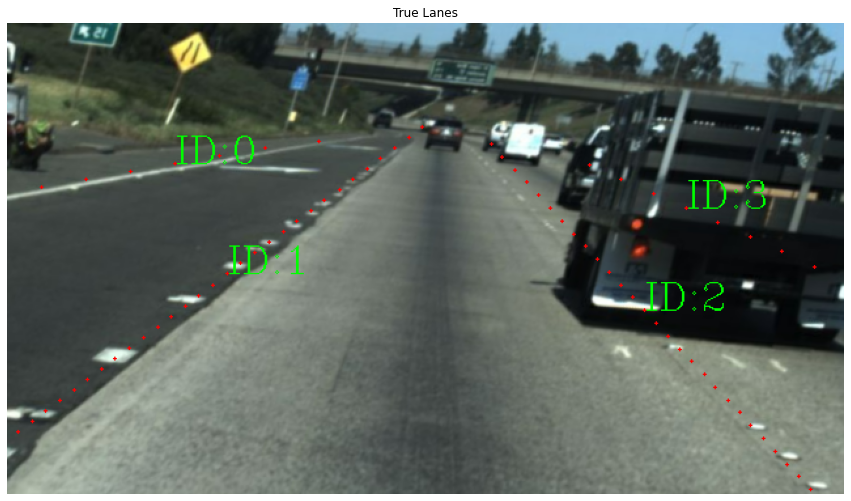

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


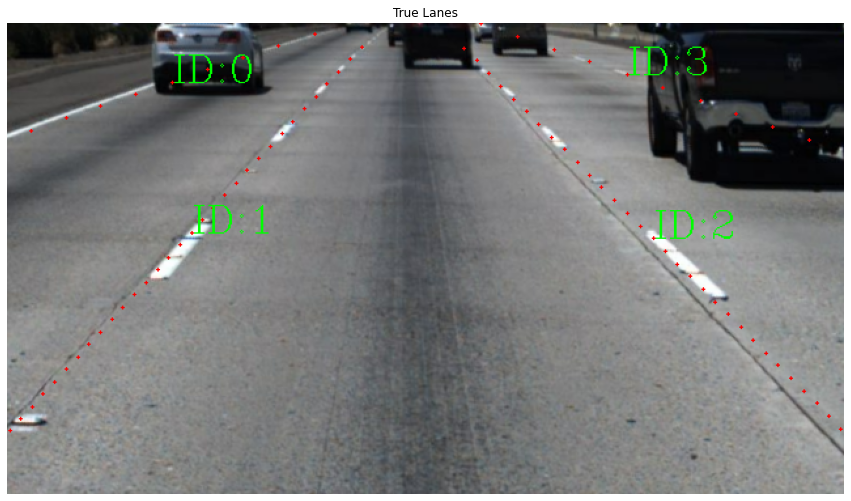

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0049019614 1.0
image size: [360, 640]


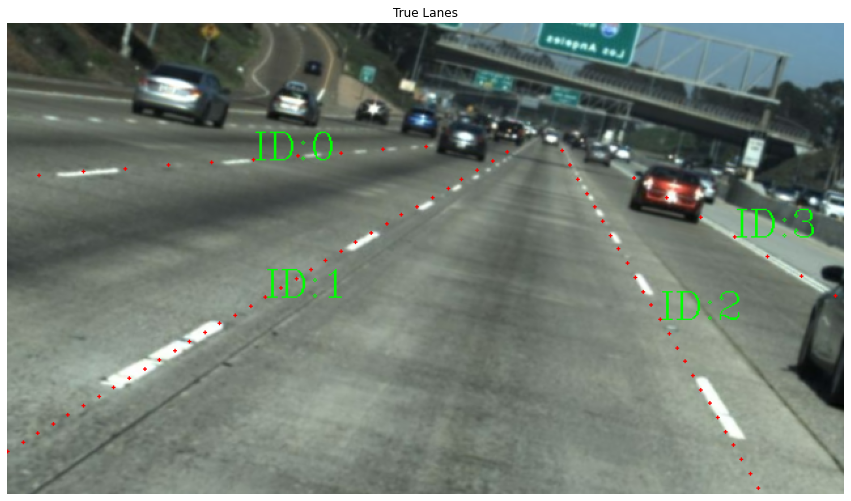

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.009803923 1.0
image size: [360, 640]


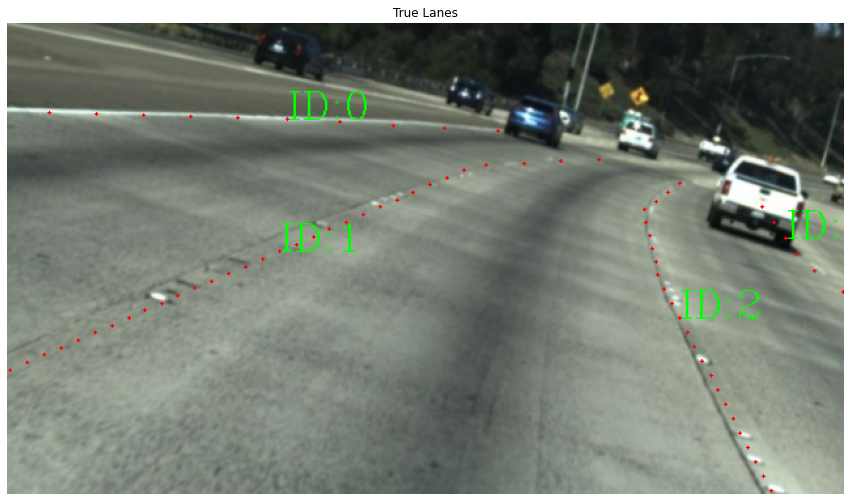

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


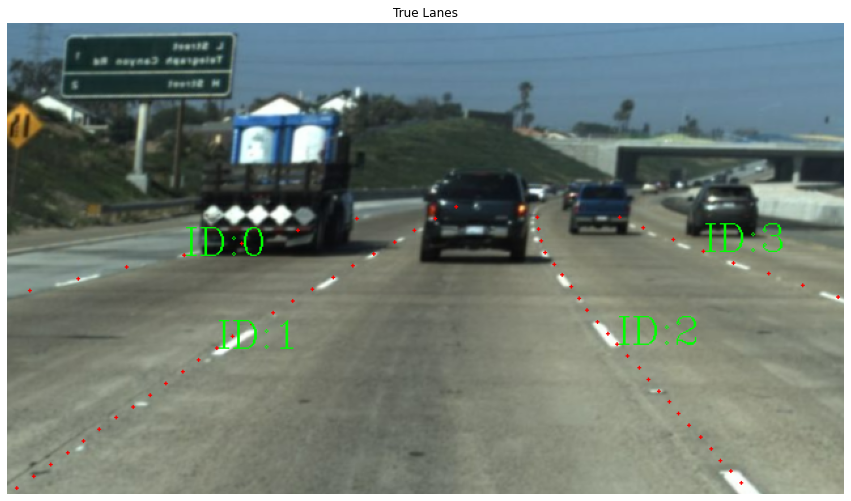

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.007843138 1.0
image size: [360, 640]


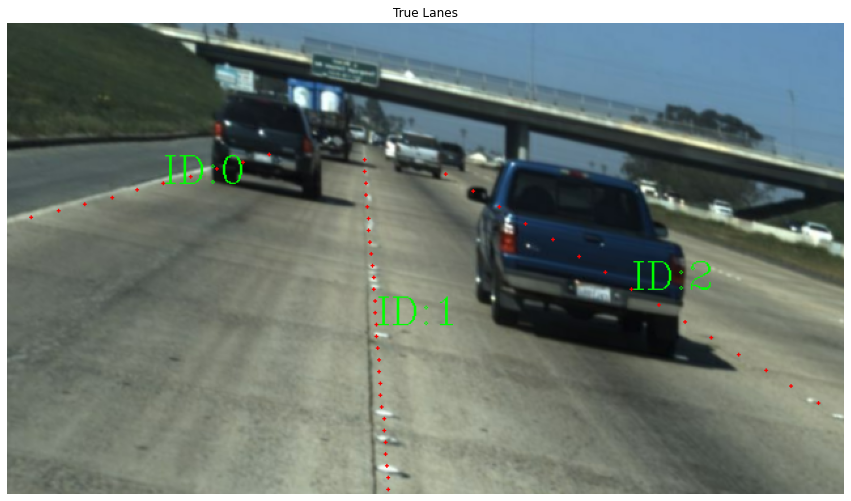

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.016666668 1.0
image size: [360, 640]


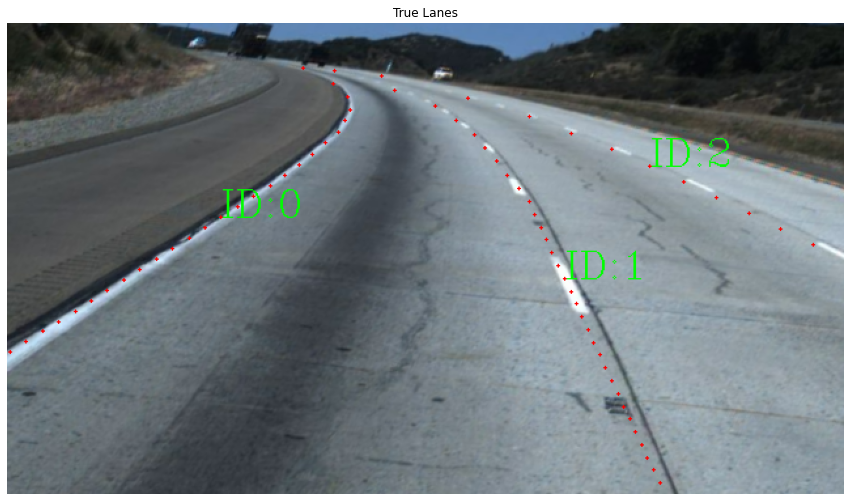

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


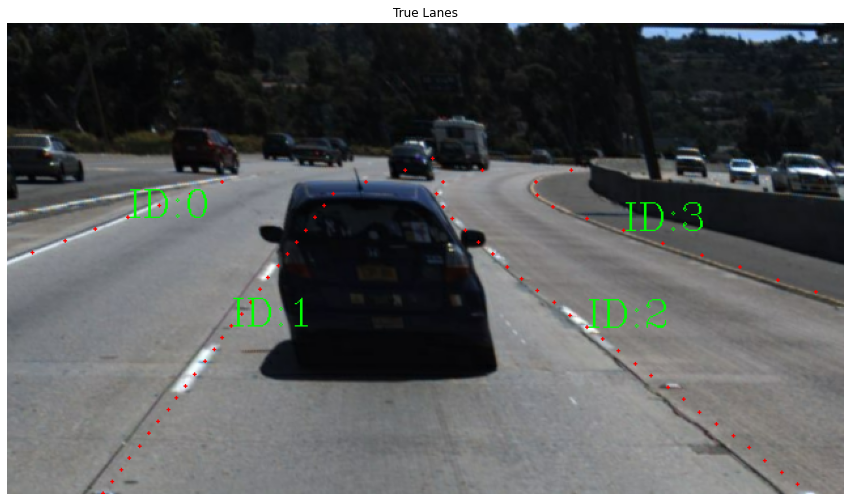

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.01666667 1.0
image size: [360, 640]


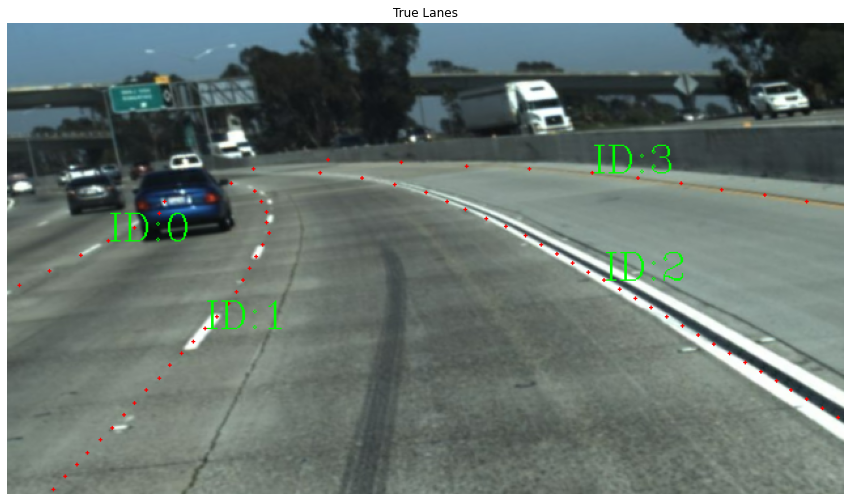

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.015686275 1.0
image size: [360, 640]


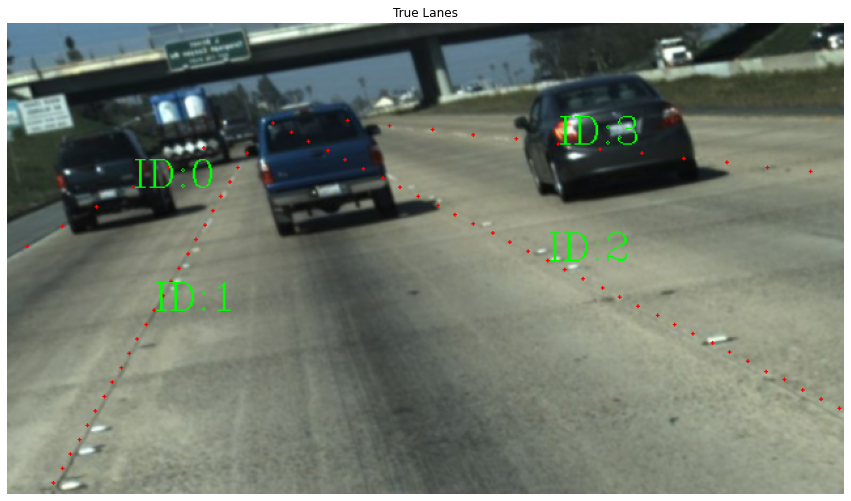

In [ ]:
#@title Display some sample augmented data { display-mode: "form" }

display_num =  1#@param {type:"integer"}
for next_element in trainds.take(display_num):

  batch_of_imgs, label = next_element
  for i in range(batch_size):
    img = draw_truelabel(batch_of_imgs[i], label[i], True)
    display([img])

In [ ]:
#@title Display some sample validation data { display-mode: "form" }

display_num =  0#@param {type:"integer"}
for next_element in valds.take(display_num):

  batch_of_imgs, label = next_element
  for i in range(batch_size):
    img = draw_truelabel(batch_of_imgs[i], label[i], True)
    display([img])

### Custom training

In [ ]:
!pip install git+https://github.com/qubvel/efficientnet
import efficientnet.keras as efn
#import efficientnet.tfkeras as efn

import keras
from tensorflow.keras import backend as K
from tensorflow.keras import layers, losses, models, Input
from tensorflow.keras.backend import sigmoid, argmax, cast
from tensorflow.keras.utils import get_custom_objects
from tensorflow.keras.layers import Activation, Softmax
from tensorflow.keras import initializers, constraints, regularizers, layers

import tensorflow.keras.optimizers  as optimizers
import tensorflow.keras.callbacks   as callbacks
import tensorflow.keras.activations as activations

from tensorflow.keras.callbacks import Callback, ModelCheckpoint, EarlyStopping, TensorBoard, CSVLogger

keras.utils = tf.keras.utils

  Cloning https://github.com/qubvel/efficientnet to /tmp/pip-req-build-wa4f5fy9
  Running command git clone -q https://github.com/qubvel/efficientnet /tmp/pip-req-build-wa4f5fy9


#### Custom Learning rate *functions*

In [ ]:
# https://github.com/4uiiurz1/keras-cosine-annealing/blob/master/cosine_annealing.py

class CosineAnnealingScheduler(callbacks.Callback):
  """
  Cosine annealing scheduler.
  """
  def __init__(self, T_max, eta_max, eta_min=0, verbose=0):
    super(CosineAnnealingScheduler, self).__init__()
    self.T_max   = T_max
    self.eta_max = eta_max
    self.eta_min = eta_min
    self.verbose = verbose
  
  def on_epoch_begin(self, epoch, logs=None):
    if not hasattr(self.model.optimizer, 'lr') :
      raise ValueError('Optimizer must have a "lr" attribute.')
      
    lr = self.eta_min+(self.eta_max-self.eta_min)*(1+math.cos(math.pi*epoch/self.T_max))/2
    K.set_value(self.model.optimizer.lr, lr)

    #print("Learning rate {}".format(lr))
    if self.verbose is not None and self.verbose > 0:
      print('Epoch %05d: CosineAnnealingScheduler setting learning '
            'rate to %s.' % (epoch + 1, lr))

  def on_epoch_end(self, epoch, logs=None):
    logs = logs or {}
    logs['lr'] = K.get_value(self.model.optimizer.lr)

#### Custom Loss *functions*

In [ ]:
#Binary Cross Entropy (BCE) function
bce = losses.BinaryCrossentropy()
#Mean Square Error (MSE) function 
mse = losses.MeanSquaredError(); 

# Custom loss functions
@tf.function
def sig(value):
  return activations.sigmoid(value)

@tf.function
def threshold(x, threshold, value):
  return tf.where(tf.greater(x, threshold), x, value)

@tf.function
def classification(true, pred):
  return cls_loss

@tf.function(jit_compile=True)
def confidence(true, pred):
  # Change shape output 35 to [5,7] 5 lanes, each lane: conf+ lower+ upper+ 4 poly
  pred        = tf.reshape(pred,[-1, tf.shape(true)[1], 1 + 2 + 4]) 
  
  # Flatten
  true_categ  = tf.reshape(true[:, :, 0], [-1,1]) 
  pred_confs  = tf.reshape(sig(pred[:, :, 0]), [-1,1])
  
  true_confs  = tf.cast((true_categ > 0), tf.float32)
  conf_loss   = bce(true_confs, pred_confs)
  
  return conf_loss
 
@tf.function(jit_compile=True)
def lowerpos(true, pred):

  # Change shape output 35 to [5,7] 5 lanes, each lane: conf+ lower+ upper+ 4 poly
  pred        = tf.reshape(pred,[-1, tf.shape(true)[1], 1 + 2 + 4])

  # Flatten
  true_categ  = tf.reshape(true[:, :, 0], [-1,1]) 
  true_confs  = tf.cast((true_categ > 0), tf.float32)
  valid_lanes = tf.equal(true_confs,1) 
    
  # Lower Loss for vertical offset for each lane marking 
  # (the lower limit of each lane)
  true_lowers = true[:, :, 1]
  pred_lowers = pred[:, :, 1]
    
  true_lowers = tf.reshape(true_lowers,[-1,1])
  pred_lowers = tf.reshape(pred_lowers,[-1,1])

  true_lowers = true_lowers * tf.cast(valid_lanes, tf.float32) #tf.boolean_mask(true_lowers, valid_lanes)
  pred_lowers = pred_lowers * tf.cast(valid_lanes, tf.float32) #tf.boolean_mask(pred_lowers, valid_lanes)
  
  lower_loss = mse(true_lowers, pred_lowers)

  return lower_loss

@tf.function(jit_compile=True)
def upperpos(true, pred):

  # Change shape output 35 to [5,7] 5 lanes, each lane: conf+ lower+ upper+ 4 poly
  pred        = tf.reshape(pred,[-1, tf.shape(true)[1], 1 + 2 + 4]) 

  # Flatten
  true_categ  = tf.reshape(true[:, :, 0], [-1,1]) 
  true_confs  = tf.cast((true_categ > 0), tf.float32)
  valid_lanes = tf.greater_equal(true_confs,1)
    
  # (the upper limit of the lane markings)
  true_uppers = tf.reshape(true[:, :, 2], [-1,1])
  pred_uppers = tf.reshape(pred[:, :, 2], [-1,1])

  true_uppers = true_uppers * tf.cast(valid_lanes, tf.float32) #tf.boolean_mask(true_uppers, valid_lanes)
  pred_uppers = pred_uppers * tf.cast(valid_lanes, tf.float32) #tf.boolean_mask(pred_uppers, valid_lanes)
  
  upper_loss  = mse(true_uppers, pred_uppers)

  return upper_loss

In [ ]:
@tf.function(jit_compile=True) 
def xla_polynomial(true, pred):

  """ Change shape output 35 to [5,7] 5 lanes, each lane: conf+ lower+ upper+ 4 poly"""
  pred = tf.reshape(pred,[-1, tf.shape(true)[1], 1 + 2 + 4])
  
  """ Flatten """
  true_categ  = tf.reshape(true[:, :, 0], [-1,1]) 
  true_confs  = tf.cast((true_categ > 0), tf.float32)
  valid_lanes = tf.equal(true_confs,1)
  
  true_points = tf.reshape(true[:, :, 3:], [-1, true.shape[2] - 3])
  pred_polys  = tf.reshape(pred[:, :, 3:], [-1, 4])
  
  # keep valid lane points only
  true_points = true_points * tf.cast(valid_lanes,tf.float32)
  true_xs     = true_points[:,:true_points.shape[1] // 2]
  ys          = true_points[:, true_points.shape[1] // 2:]
  
  pred_polys  = pred_polys * tf.cast(valid_lanes,tf.float32) 
  pred_xs     = tf.reshape(pred_polys[:, 0], [-1,1]) * ys**3 + \
                tf.reshape(pred_polys[:, 1], [-1,1]) * ys**2 + \
                tf.reshape(pred_polys[:, 2], [-1,1]) * ys + \
                tf.reshape(pred_polys[:, 3], [-1,1])
  
  """
  # add weight to lane points before calculating loss
  # 1. Normalize weight for overall points
  #    Lanes with more points shall not have more weights on the cost function
  # 2. Distance weight
  #    The further points the heavier weight added 
  """
  valid_xs  = tf.greater_equal(true_xs, 0)
  #tf.print("valid_xs:", [valid_xs], output_stream=sys.stdout)
  
  """ 1. Normalize weight for overall points
  # put more weight with less points in such as adjacent lanes
  """
  normalize_w  = (tf.reduce_sum(tf.cast(valid_xs, tf.float32)) / 
                  tf.reduce_sum(tf.cast(valid_xs, tf.float32),1))**0.5
  normalize_w  = tf.reshape(normalize_w,[-1,1])
  #tf.print("normalize_w:", [normalize_w], output_stream=sys.stdout)

  """ 2. Distance weight 
  # put more weight on each point
  # 2.1. the futher the more weight, or
  # 2.2. the closer the more weight
  """
  Starting_val = tf.dtypes.cast(valid_xs[:,0], tf.float32) # [1.0,1.0,...,1.0]
  Range_shape  = tf.dtypes.cast(tf.shape(valid_xs)[1], tf.float32)
  distance_w   = tf.map_fn(fn=lambda t: tf.range(t, t +1e-5*Range_shape, delta= 1e-5), 
                           elems= Starting_val) 
  
  """ 3. Focal loss"""
  # put more weights on hard-to-learn lane
  invalid_xs  = tf.less(true_xs, 0)
  pred_xs     = tf.where(invalid_xs, -1e5, pred_xs)
  #tf.print("change invalid xs:", [true_xs, pred_xs], output_stream=sys.stdout)
  Floss   = tf.reduce_sum((pred_xs - true_xs)**2,1) / (tf.reduce_sum((pred_xs - true_xs)**2)+1e-9)
  Floss_w = 2 * tf.math.pow(1/(1- Floss), 0.5)
  Floss_w = tf.reshape(Floss_w,[-1,1])
  #tf.print("floss:", [Floss,Floss_w], output_stream=sys.stdout)
  
  pred_xs, true_xs = pred_xs * normalize_w, true_xs * normalize_w
  #pred_xs, true_xs = pred_xs * Floss_w, true_xs * Floss_w
  #pred_xs, true_xs = pred_xs * distance_w, true_xs * distance_w

  """Remove invalid xs"""
  pred_xs   = pred_xs * tf.cast(valid_xs,tf.float32) #tf.boolean_mask(pred_xs, valid_xs)
  true_xs   = true_xs * tf.cast(valid_xs,tf.float32) #tf.boolean_mask(true_xs, valid_xs)
  #tf.print("remove invalid_xs:", [true_xs, pred_xs], output_stream=sys.stdout)

  poly_loss = tf.reduce_sum(threshold((pred_xs - true_xs)**2, (15 / 720.)**2 , 0.)) 
  poly_loss = poly_loss/tf.reduce_sum(tf.cast(valid_lanes,tf.float32))
  poly_loss = poly_loss/tf.reduce_sum(tf.cast(valid_xs,tf.float32))
  
  return 300*poly_loss

In [ ]:
@tf.function
def polynomial(true, pred):

  """ Change shape output 35 to [5,7] 5 lanes, each lane: conf+ lower+ upper+ 4 poly"""
  pred = tf.reshape(pred,[-1, tf.shape(true)[1], 1 + 2 + 4])
  
  """ Flatten """
  true_categ  = tf.reshape(true[:, :, 0], [-1,1]) 
  true_confs  = tf.cast((true_categ > 0), tf.float32)
  valid_lanes = tf.equal(true_confs,1)
  
  true_points = tf.reshape(true[:, :, 3:], [-1, true.shape[2] - 3])
  pred_polys  = tf.reshape(pred[:, :, 3:], [-1, 4])
  
  flattenlanes = tf.reshape(valid_lanes, [-1])
  # keep valid lane points only
  true_points = tf.boolean_mask(true_points, flattenlanes)
  
  true_xs     = true_points[:,:true_points.shape[1] // 2]
  ys          = true_points[:, true_points.shape[1] // 2:]
  
  pred_polys  = tf.boolean_mask(pred_polys, flattenlanes)
  pred_xs     = tf.reshape(pred_polys[:, 0], [-1,1]) * ys**3 + \
                tf.reshape(pred_polys[:, 1], [-1,1]) * ys**2 + \
                tf.reshape(pred_polys[:, 2], [-1,1]) * ys + \
                tf.reshape(pred_polys[:, 3], [-1,1])
  
  valid_xs  = tf.greater_equal(true_xs, 0)
  #tf.print("valid_xs:", [valid_xs], output_stream=sys.stdout)
  
  """ Normalize weight for overall points
  # put more weight with less points in such as adjacent lanes
  """
  normalize_w  = (tf.reduce_sum(tf.cast(valid_xs, tf.float32)) / 
                  tf.reduce_sum(tf.cast(valid_xs, tf.float32),1))**0.5
  normalize_w  = tf.reshape(normalize_w,[-1,1])
  #tf.print("normalize_w:", [normalize_w], output_stream=sys.stdout)

  pred_xs, true_xs = pred_xs * normalize_w, true_xs * normalize_w
  
  """Remove invalid xs"""
  pred_xs   = tf.boolean_mask(pred_xs, valid_xs)
  true_xs   = tf.boolean_mask(true_xs, valid_xs)
  #tf.print("remove invalid_xs:", [true_xs, pred_xs], output_stream=sys.stdout)

  poly_loss = tf.reduce_sum(threshold((pred_xs - true_xs)**2, (15 / 720.)**2 , 0.)) 
  poly_loss = poly_loss/tf.reduce_sum(tf.cast(valid_lanes,tf.float32))
  poly_loss = poly_loss/tf.reduce_sum(tf.cast(valid_xs,tf.float32))
  
  return 300*poly_loss

In [ ]:
@tf.function
def multitask_loss(true, pred):

  loss  = confidence(true, pred)  # confidence score loss
  loss += lowerpos(true, pred)   # top loss
  loss += upperpos(true, pred)   # bottom loss
  loss += polynomial(true, pred) # polynomial loss
  
  return loss

#### Custom Optimizer *functions*

In [ ]:
#@title RAdam activation
# Code Source: https://github.com/CyberZHG/keras-radam/blob/master/keras_radam/optimizers.py
class RAdam(optimizers.Optimizer):
    """RAdam optimizer.
    # Arguments
        lr: float >= 0. Learning rate.
        beta_1: float, 0 < beta < 1. Generally close to 1.
        beta_2: float, 0 < beta < 1. Generally close to 1.
        epsilon: float >= 0. Fuzz factor. If `None`, defaults to `K.epsilon()`.
        decay: float >= 0. Learning rate decay over each update.
        weight_decay: float >= 0. Weight decay for each param.
        amsgrad: boolean. Whether to apply the AMSGrad variant of this
            algorithm from the paper "On the Convergence of Adam and
            Beyond".
        total_steps: int >= 0. Total number of training steps. Enable warmup by setting a positive value.
        warmup_proportion: 0 < warmup_proportion < 1. The proportion of increasing steps.
        min_lr: float >= 0. Minimum learning rate after warmup.
    # References
        - [Adam - A Method for Stochastic Optimization](https://arxiv.org/abs/1412.6980v8)
        - [On the Convergence of Adam and Beyond](https://openreview.net/forum?id=ryQu7f-RZ)
        - [On The Variance Of The Adaptive Learning Rate And Beyond](https://arxiv.org/pdf/1908.03265v1.pdf)
    """

    def __init__(self, lr=0.001, beta_1=0.9, beta_2=0.999,
                 epsilon=None, decay=0., weight_decay=0., amsgrad=False,
                 total_steps=0, warmup_proportion=0.1, min_lr=0., **kwargs):
        super(RAdam, self).__init__(**kwargs)
        with K.name_scope(self.__class__.__name__):
            self.iterations = K.variable(0, dtype='int64', name='iterations')
            self.lr = K.variable(lr, name='lr')
            self.beta_1 = K.variable(beta_1, name='beta_1')
            self.beta_2 = K.variable(beta_2, name='beta_2')
            self.decay = K.variable(decay, name='decay')
            self.weight_decay = K.variable(weight_decay, name='weight_decay')
            self.total_steps = K.variable(total_steps, name='total_steps')
            self.warmup_proportion = K.variable(warmup_proportion, name='warmup_proportion')
            self.min_lr = K.variable(lr, name='min_lr')
        if epsilon is None:
            epsilon = K.epsilon()
        self.epsilon = epsilon
        self.initial_decay = decay
        self.initial_weight_decay = weight_decay
        self.initial_total_steps = total_steps
        self.amsgrad = amsgrad

    def get_updates(self, loss, params):
        grads = self.get_gradients(loss, params)
        self.updates = [K.update_add(self.iterations, 1)]

        lr = self.lr

        if self.initial_decay > 0:
            lr = lr * (1. / (1. + self.decay * K.cast(self.iterations, K.dtype(self.decay))))

        t = K.cast(self.iterations, K.floatx()) + 1

        if self.initial_total_steps > 0:
            warmup_steps = self.total_steps * self.warmup_proportion
            decay_steps = self.total_steps - warmup_steps
            lr = K.switch(
                t <= warmup_steps,
                lr * (t / warmup_steps),
                lr * (1.0 - K.minimum(t, decay_steps) / decay_steps),
            )

        ms = [K.zeros(K.int_shape(p), dtype=K.dtype(p), name='m_' + str(i)) for (i, p) in enumerate(params)]
        vs = [K.zeros(K.int_shape(p), dtype=K.dtype(p), name='v_' + str(i)) for (i, p) in enumerate(params)]

        if self.amsgrad:
            vhats = [K.zeros(K.int_shape(p), dtype=K.dtype(p), name='vhat_' + str(i)) for (i, p) in enumerate(params)]
        else:
            vhats = [K.zeros(1, name='vhat_' + str(i)) for i in range(len(params))]

        self.weights = [self.iterations] + ms + vs + vhats

        beta_1_t = K.pow(self.beta_1, t)
        beta_2_t = K.pow(self.beta_2, t)

        sma_inf = 2.0 / (1.0 - self.beta_2) - 1.0
        sma_t = sma_inf - 2.0 * t * beta_2_t / (1.0 - beta_2_t)

        for p, g, m, v, vhat in zip(params, grads, ms, vs, vhats):
            m_t = (self.beta_1 * m) + (1. - self.beta_1) * g
            v_t = (self.beta_2 * v) + (1. - self.beta_2) * K.square(g)

            m_corr_t = m_t / (1.0 - beta_1_t)
            if self.amsgrad:
                vhat_t = K.maximum(vhat, v_t)
                v_corr_t = K.sqrt(vhat_t / (1.0 - beta_2_t) + self.epsilon)
                self.updates.append(K.update(vhat, vhat_t))
            else:
                v_corr_t = K.sqrt(v_t / (1.0 - beta_2_t) + self.epsilon)

            r_t = K.sqrt((sma_t - 4.0) / (sma_inf - 4.0) *
                         (sma_t - 2.0) / (sma_inf - 2.0) *
                         sma_inf / sma_t)

            p_t = K.switch(sma_t > 5, r_t * m_corr_t / v_corr_t, m_corr_t)

            if self.initial_weight_decay > 0:
                p_t += self.weight_decay * p

            p_t = p - lr * p_t

            self.updates.append(K.update(m, m_t))
            self.updates.append(K.update(v, v_t))
            new_p = p_t

            # Apply constraints.
            if getattr(p, 'constraint', None) is not None:
                new_p = p.constraint(new_p)

            self.updates.append(K.update(p, new_p))
        return self.updates

    def get_config(self):
        config = {
            'lr': float(K.get_value(self.lr)),
            'beta_1': float(K.get_value(self.beta_1)),
            'beta_2': float(K.get_value(self.beta_2)),
            'decay': float(K.get_value(self.decay)),
            'weight_decay': float(K.get_value(self.weight_decay)),
            'epsilon': self.epsilon,
            'amsgrad': self.amsgrad,
            'total_steps': float(K.get_value(self.total_steps)),
            'warmup_proportion': float(K.get_value(self.warmup_proportion)),
            'min_lr': float(K.get_value(self.min_lr)),
        }
        base_config = super(RAdam, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))


In [ ]:
#@title AdaBelief
#https://qiita.com/T-STAR/items/08ff024512ce56958ddc

class MultiOptimizerV3(optimizers.Optimizer):
  def __init__(self, learning_rate=0.01, momentum=0.0, centered=True, rho=0.0, centered_v=True, epsilon=1e-7, belief=False, name='MultiOptimizerV3', **kwargs):
    super().__init__(name, **kwargs)
    self._set_hyper('learning_rate', kwargs.get('lr', learning_rate))
    self._set_hyper('decay', self._initial_decay)
    self.momentum = momentum
    self.centered = centered if momentum!=0.0 else False
    self.rho = rho
    self.centered_v = centered_v if rho!=0.0 else False
    self.epsilon = epsilon or K.epsilon()
    self.belief = belief if rho!=0.0 and momentum!=0.0 else False

  def get_config(self):
    config = super(MultiOptimizerV3, self).get_config()
    config.update({
            'learning_rate': self._serialize_hyperparameter('learning_rate'),
            'decay': self._serialize_hyperparameter('decay'),
            'momentum': self.momentum,
            'centered': self.centered,
            'rho': self.rho,
            'centered_v': self.centered_v,
            'epsilon': self.epsilon,
            'belief': self.belief,
        })
    return config

  def _create_slots(self, var_list):
    for var in var_list:
      if self.momentum!=0.0:
        self.add_slot(var, 'm')
      if self.rho!=0.0:
        self.add_slot(var, 'v')

  def _resource_apply_dense(self, grad, var, apply_state=None):
    var_device, var_dtype = var.device, var.dtype.base_dtype
    lr_t = self._decayed_lr(var_dtype)
    local_step = tf.cast(self.iterations+1, var_dtype)

    updates = []

    if self.momentum!=0.0:
      # MomentumSGD
      m = self.get_slot(var, 'm')
      m_t = m.assign( self.momentum*m + (1.0-self.momentum)*grad )
      if self.centered:
        denominator = 1.0-(self.momentum**local_step)
        m_t_hat = m_t / denominator
      else:
        m_t_hat = m_t
      updates.append(m_t)
    else:
      m_t_hat = grad


    if self.rho!=0.0:
      #RMSprop
      if self.belief: # AdaBelief
        g2 = (grad-m_t)**2
        epsilon_b = self.epsilon
      else:
        g2 = grad**2
        epsilon_b = 0.0

      v = self.get_slot(var, 'v')
      v_t = v.assign( self.rho*v + (1.0-self.rho)*g2 )

      if self.centered_v:
        denominator = 1.0-(self.rho**local_step)
        lr_t = lr_t / ((((v_t+epsilon_b)/denominator)**0.5)+self.epsilon)
      else:
        lr_t = lr_t / ((v_t**0.5)+self.epsilon)
      updates.append(v_t)

    # Update var
    var_update = var.assign(var - lr_t*m_t_hat)
    updates.append(var_update)
    return tf.group(*updates)

  def _resource_apply_sparse(self, grad, var, indices):
    raise NotImplementedError("not implemented")

In [ ]:
# Create an optimizer.
choose_optimizer = 'AdaBelief'

if choose_optimizer == 'Adam':
  print("choose Adam optimizer")
  Opt = optimizers.Adam(learning_rate=5.0e-4)
elif choose_optimizer == 'AdaBelief':
  print("choose AdaBelief optimizer")
  Opt = MultiOptimizerV3(learning_rate=0.001,momentum=0.9,rho=0.999,epsilon=1e-07,belief=True)
else:
  print("choose Ranger optimizer")
  radam  = tfa.optimizers.RectifiedAdam(learning_rate=3.0e-5)
  Opt    = tfa.optimizers.Lookahead(radam,sync_period=6,slow_step_size=0.5)

choose AdaBelief optimizer


#### Custom Activation *functions*

In [ ]:
act = 'Mish'  # 'swish' # 'relu' #'Snake'  #'hSwish'

In [ ]:
#@title Import some libs
from keras.backend import sigmoid
from keras.utils.generic_utils import get_custom_objects
from keras.layers import Activation

In [ ]:
#@title Swish Activation
@tf.function
def swish(x, beta = 1):
    return (x * sigmoid(beta * x))
get_custom_objects().update({'swish': Activation(swish)})

In [ ]:
#@title Hard Swish activation
class hSwish(Activation):
    '''
    Hard Swish Activation Function.
    .. math::
        hswish(x) = x * RELU6(x+3)/6 
    Shape:
        - Input: Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
        - Output: Same shape as the input.
    Examples:
        >>> X = Activation('hSwish', name="conv1_act")(X_input)
    '''

    def __init__(self, activation, **kwargs):
      super(hSwish, self).__init__(activation, **kwargs)
      self.__name__ = 'Hard_Swish'

@tf.function
def hswish(x):
    return x * (K.relu(x + 3., max_value = 6.) / 6.)

get_custom_objects().update({'hSwish': hSwish(hswish)})

In [ ]:
#@title Snake activation
#https://arxiv.org/pdf/2006.08195.pdf
class SnakeL(layers.Layer):
  '''
  Snake activation function $X + (1/b)*sin^2(b*X)$. Proposed to learn periodic targets.
    
    Y = Snake(beta=0.5, trainable=False)(X)
    
  ----------
  Ziyin, L., Hartwig, T. and Ueda, M., 2020. Neural networks fail to learn periodic functions 
  and how to fix it. arXiv preprint arXiv:2006.08195.
    
  '''
  def __init__(self, beta=0.5, trainable=False, **kwargs):
    super(Snake, self).__init__(**kwargs)
    self.supports_masking = True
    self.beta = beta
    self.trainable = trainable
    self.__name__ = 'Snake'

  def build(self, input_shape):
    self.beta_factor = K.variable(self.beta, dtype=K.floatx(), name='beta_factor')
    if self.trainable:
      self._trainable_weights.append(self.beta_factor)

    super(Snake, self).build(input_shape)

  def call(self, inputs, mask=None):
    return snakeL_(inputs, self.beta_factor)

  def get_config(self):
    config = {'beta': self.get_weights()[0] if self.trainable else self.beta, 'trainable': self.trainable}
    base_config = super(Snake, self).get_config()
    return dict(list(base_config.items()) + list(config.items()))

  def compute_output_shape(self, input_shape):
    return input_shape

@tf.function
def snakeL_(X, beta):
  return X + (1/beta)*math.square(math.sin(beta*X))

class Snake(Activation):
    '''
    Snake Activation Function.
    .. math::
        Snake activation function $X + (1/b)*sin^2(b*X)$. Proposed to learn periodic targets.
    Shape:
        - Input: Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
        - Output: Same shape as the input.
    Examples:
        >>> X = Activation('Snake', name="conv1_act")(X_input)
    '''

    def __init__(self, activation, **kwargs):
      super(Snake, self).__init__(activation, **kwargs)
      self.__name__ = 'Snake'

@tf.function
def snake(x, beta=0.5):
  return x + (1/beta)*K.square(K.sin(beta*x))

get_custom_objects().update({'Snake': Snake(snake)}) 

In [ ]:
#@title Mish activation
class Mish(Activation):
    '''
    Mish Activation Function.
    .. math::
        mish(x) = x * tanh(softplus(x)) = x * tanh(ln(1 + e^{x}))
    Shape:
        - Input: Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
        - Output: Same shape as the input.
    Examples:
        >>> X = Activation('Mish', name="conv1_act")(X_input)
    '''

    def __init__(self, activation, **kwargs):
        super(Mish, self).__init__(activation, **kwargs)
        self.__name__ = 'Mish'

@tf.function
def mish(x):
    return x*K.tanh(K.softplus(x))

get_custom_objects().update({'Mish': Mish(mish)})

#### Model

In [ ]:
#@title ChannelAttentionModule

class ChannelAttentionModule(layers.Layer):
  def __init__(self, ratio=8):
    '''
    paper: https://arxiv.org/abs/1807.06521
    code: https://gist.github.com/innat/99888fa8065ecbf3ae2b297e5c10db70
    '''
    super(ChannelAttentionModule, self).__init__()
    self.ratio = ratio
    self.gapavg = layers.GlobalAveragePooling2D()
    self.gmpmax = layers.GlobalMaxPooling2D()
        
  def build(self, input_shape):
                           
    self.conv1 = layers.Dense(input_shape[-1]//self.ratio,
                              activation='relu',
                              kernel_initializer='he_normal',
                              use_bias=True, bias_initializer='zeros')
 
    self.conv2 = layers.Dense(input_shape[-1],
                              kernel_initializer='he_normal',
                              use_bias=True,bias_initializer='zeros')
    
    super(ChannelAttentionModule, self).build(input_shape)
  
  def get_config(self):
    config = super(ChannelAttentionModule, self).get_config()
    config.update({
            'ratio': self.ratio,
        })
    return config

  @tf.function(jit_compile= True)
  def call(self, inputs):
    
    # compute gap and gmp pooling 
    gapavg = self.gapavg(inputs)
    gmpmax = self.gmpmax(inputs)
    gapavg = layers.Reshape((1, 1, gapavg.shape[1]))(gapavg)   
    gmpmax = layers.Reshape((1, 1, gmpmax.shape[1]))(gmpmax)   
    
    # forward passing to the respected layers
    gapavg_out = self.conv2(self.conv1(gapavg))
    gmpmax_out = self.conv2(self.conv1(gmpmax))
    return tf.math.sigmoid(gapavg_out + gmpmax_out)
    
  def get_output_shape_for(self, input_shape):
    return self.compute_output_shape(input_shape)

  def compute_output_shape(self, input_shape):
    output_len = input_shape[3]
    return (input_shape[0], output_len)

In [ ]:
#@title SpatialAttentionModule

class SpatialAttentionModule(layers.Layer):
  def __init__(self):
    '''
    paper: https://arxiv.org/abs/1807.06521
    code: https://gist.github.com/innat/99888fa8065ecbf3ae2b297e5c10db70
    '''
    super(SpatialAttentionModule, self).__init__()
  
    self.conv1 = layers.Dense(64,activation=tf.nn.relu6,
                              kernel_initializer='he_normal',
                              use_bias=True, bias_initializer='zeros')
    self.conv2 = layers.Dense(32,activation=tf.nn.relu6,
                              kernel_initializer='he_normal',
                              use_bias=True, bias_initializer='zeros')
    self.conv3 = layers.Dense(16,activation=tf.nn.relu6,
                              kernel_initializer='he_normal',
                              use_bias=True, bias_initializer='zeros')
    self.conv4 = layers.Dense(1,activation=tf.nn.relu6,
                              kernel_initializer='he_normal',
                              use_bias=True, bias_initializer='zeros')
  
  @tf.function(jit_compile= True)
  def call(self, inputs):
    avg_out = tf.reduce_mean(inputs, axis=3)
    max_out = tf.reduce_max(inputs,  axis=3)
    x = tf.stack([avg_out, max_out], axis=3) 
    x = self.conv1(x)
    x = self.conv2(x)
    x = self.conv3(x)
    return self.conv4(x)

In [ ]:
def AVGAttention(blockInput):
  
  x = layers.BatchNormalization()(blockInput)
  x = layers.Activation(act)(x)

  CAN  = ChannelAttentionModule()
  SPN  = SpatialAttentionModule()
  
  canx = CAN(x)*x
  spnx = SPN(canx)*canx  
  cgapx = layers.GlobalAveragePooling2D()(canx)
  sgapx = layers.GlobalAveragePooling2D()(spnx)

  att = layers.Maximum()([cgapx, sgapx])
  x   = layers.Add()([x, att])
  
  return x

In [ ]:
### Base model
#First, instantiate a base model with pre-trained weights.
backbone = efn.EfficientNetB0(weights='imagenet',
                             include_top=False, 
                             input_shape=(img_shape[0],img_shape[1],3))

inputs = backbone.input

x = backbone.output
x = AVGAttention(x) 
# Convert features of shape `base_model.output_shape[1:]` to vectors
x = layers.GlobalAveragePooling2D()(x)

if MIXED_PRECISION:
  x = layers.Dense(35, name='dense_logits')(x)  
  outputs = layers.Activation('linear', dtype='float32', name='output')(x) 
  print('Outputs dtype: %s' % outputs.dtype.name)
else:
  outputs = layers.Dense(units=35, activation="linear", name='output')(x)

LaneModel = models.Model(inputs,outputs,name="Lane_EfficientNet")
#print(LaneModel.summary())

#### Callbacks

In [ ]:
class DisplayCallback(Callback):
  """
  """
  def on_epoch_end(self, epoch, logs=None):
    clear_output(wait=True)
    show_predictions(dataset=dataset['val'], num=3)
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [ ]:
# Callbacks
dir = '/content/drive/My Drive/Colab_logs/Checkpoint_'+datetime.now().strftime("%Y%m%d-%H%M%S")
model_dir = dir + '_efficientB0.h5'

cp_cfg         = {'filepath':model_dir,'monitor':'val_loss','verbose':0,'save_best_only':True,'save_weights_only':False,'mode':'auto'}
early_cfg      = {'monitor':'val_loss','min_delta': 0,'patience': 60,'verbose': 1,'mode':'auto'}
Scheduler_cfg  = {'T_max':285,'eta_max':3.0e-4,'eta_min':0,'verbose':0}
csvlog_dir     = dir + "_model_history_log.csv"

In [ ]:
# Restart training
# Prepare a directory to store all the checkpoints.
checkpoint_dir = dir + "/ckpt"
if not os.path.exists(checkpoint_dir): os.makedirs(checkpoint_dir)

callback = [         
  CosineAnnealingScheduler(**Scheduler_cfg),
  EarlyStopping(**early_cfg),
  CSVLogger(csvlog_dir,append=True),
  TensorBoard(log_dir= dir),
  #ModelCheckpoint(**cp_cfg),
  ]

In [ ]:
checkpoints = False
if checkpoints:
  latest_checkpoint = "/content/drive/MyDrive/Colab_logs/Checkpoint_20210204-034923_efficientB0.h5"
  print("Restoring from", latest_checkpoint)
  customObjects = {'MultiOptimizerV3':MultiOptimizerV3(learning_rate=0.001,momentum=0.9,rho=0.999,epsilon=1e-07,belief=True),
                   'mish':Activation(mish),
                   'multitask_loss':multitask_loss,
                   'confidence':confidence,
                   'lowerpos':lowerpos,
                   'upperpos':upperpos,
                   'polynomal':polynomal}

  LaneModel = tf.keras.models.load_model(latest_checkpoint,custom_objects= customObjects)
  LaneModel.compile(optimizer=Opt,loss=[multitask_loss],
                    metrics=[confidence,lowerpos,upperpos,polynomial])

else:
  print("Creating a new model")
  LaneModel.compile(optimizer=Opt,loss=[multitask_loss],metrics=[confidence,lowerpos,upperpos])

Creating a new model


### Training

In [ ]:
fit_cfg  = {'x':trainds,
           'steps_per_epoch':num_train//batch_size, 
           'validation_data':valds, 
           'validation_steps':num_val//batch_size,
           'epochs':epochs, 
           'verbose':1,
           'callbacks':callback
          }             

history = LaneModel.fit(**fit_cfg)

Epoch 1/2695


/usr/local/lib/python3.7/dist-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


204/204 [==============================] - 288s 598ms/step - loss: 16.3825 - confidence: 0.2233 - lowerpos: 0.0298 - upperpos: 0.0622 - val_loss: 15.4634 - val_confidence: 0.1877 - val_lowerpos: 0.0214 - val_upperpos: 0.0566
Epoch 2/2695
204/204 [==============================] - 111s 546ms/step - loss: 6.1803 - confidence: 0.1538 - lowerpos: 0.0111 - upperpos: 0.0285 - val_loss: 5.7873 - val_confidence: 0.1488 - val_lowerpos: 0.0066 - val_upperpos: 0.0184
Epoch 3/2695
204/204 [==============================] - 109s 536ms/step - loss: 4.8793 - confidence: 0.1352 - lowerpos: 0.0081 - upperpos: 0.0218 - val_loss: 4.5274 - val_confidence: 0.1297 - val_lowerpos: 0.0050 - val_upperpos: 0.0157
Epoch 4/2695
204/204 [==============================] - 109s 534ms/step - loss: 4.4248 - confidence: 0.1245 - lowerpos: 0.0064 - upperpos: 0.0188 - val_loss: 5.2371 - val_confidence: 0.1194 - val_lowerpos: 0.0038 - val_upperpos: 0.0152
Epoch 5/2695
204/204 [==============================] - 110s 540ms/

### Saving results

In [ ]:
save_model_path = "/content/drive/My Drive/Colab_logs/polylanenet" + "_" + datetime.now().strftime("%Y%m%d-%H%M%S") + ".tfcache.h5"

LaneModel.save_weights(save_model_path, overwrite=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:40: MatplotlibDeprecationWarning: Unrecognized location 'loss'. Falling back on 'best'; valid locations are
	best
	upper right
	upper left
	lower left
	lower right
	right
	center left
	center right
	lower center
	upper center
	center
This will raise an exception in 3.3.


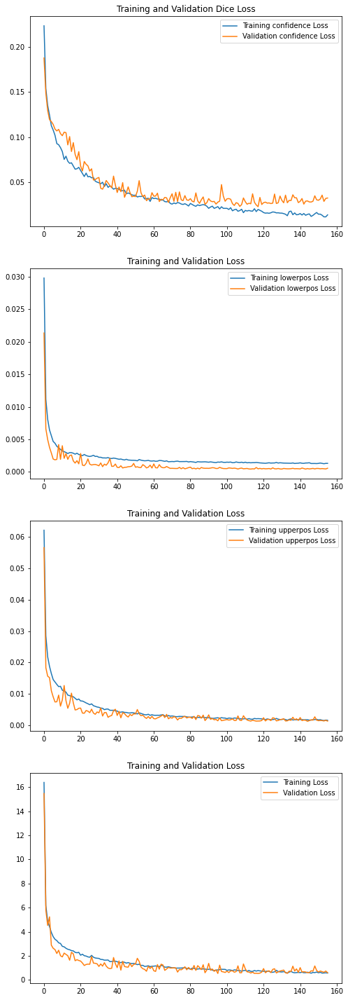

In [ ]:
loss =  history.history['loss']
val_loss = history.history['val_loss']

confidence = history.history['confidence']
val_confidence = history.history['val_confidence']

lowerpos = history.history['lowerpos']
val_lowerpos = history.history['val_lowerpos']

upperpos = history.history['upperpos']
val_upperpos = history.history['val_upperpos']

plt.figure(figsize=(8, 32))
plt.subplot(5, 1, 1)
plt.plot(confidence, label='Training confidence Loss')
plt.plot(val_confidence, label='Validation confidence Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Dice Loss')

plt.subplot(5, 1, 2)
plt.plot(lowerpos, label='Training lowerpos Loss')
plt.plot(val_lowerpos, label='Validation lowerpos Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.subplot(5, 1, 3)
plt.plot(upperpos, label='Training upperpos Loss')
plt.plot(val_upperpos, label='Validation upperpos Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.subplot(5, 1, 4)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='loss')
plt.title('Training and Validation Loss')

plt.show()

# Evaluation

In [ ]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = LaneModel.evaluate(valds, batch_size=5, steps = num_val//batch_size)
print("result:", results)

Evaluate on test data
22/22 [==============================] - 2s 94ms/step - loss: 0.6054 - confidence: 0.0326 - lowerpos: 5.4411e-04 - upperpos: 0.0013
result: [0.6054433584213257, 0.032603491097688675, 0.0005441145040094852, 0.0013418508460745215]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


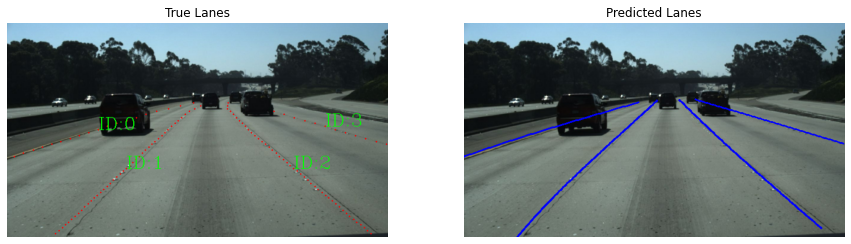

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0058823535 1.0
image size: [360, 640]


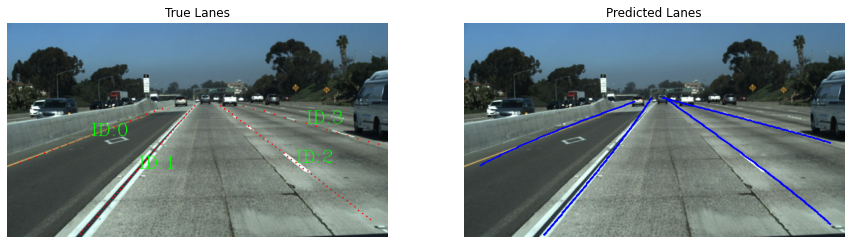

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


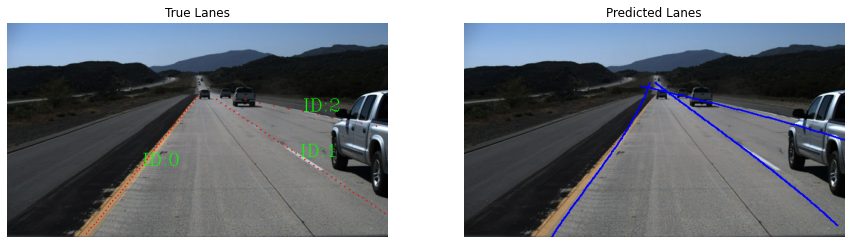

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


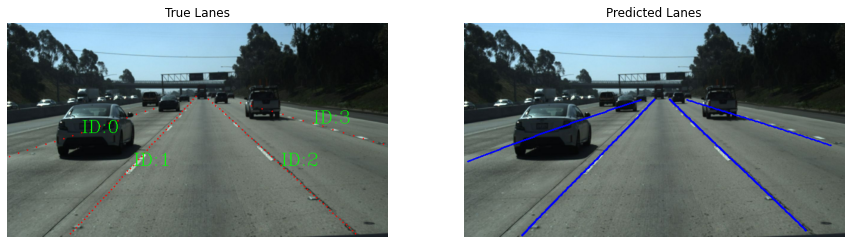

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0068627456 1.0
image size: [360, 640]


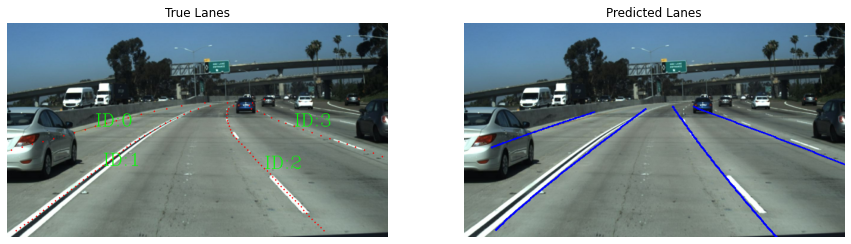

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


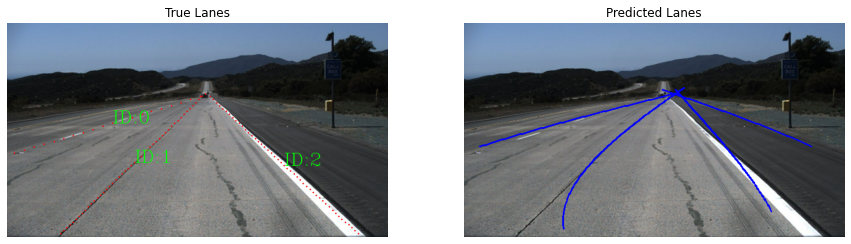

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


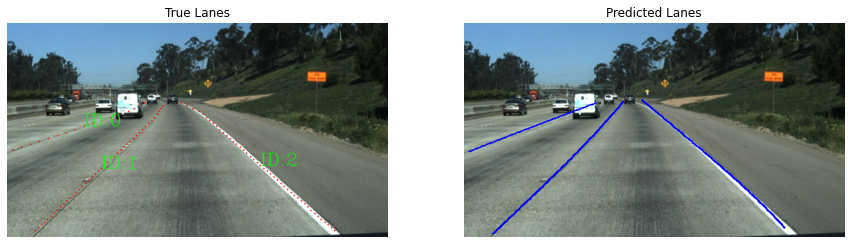

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0009803922 1.0
image size: [360, 640]


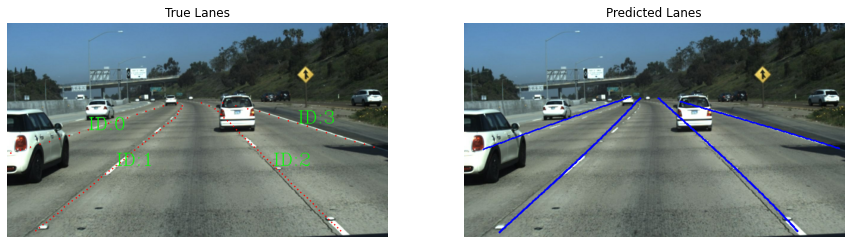

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.009803922 1.0
image size: [360, 640]


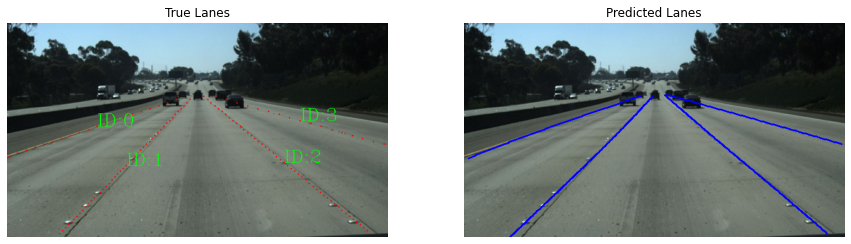

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.008823531 1.0
image size: [360, 640]


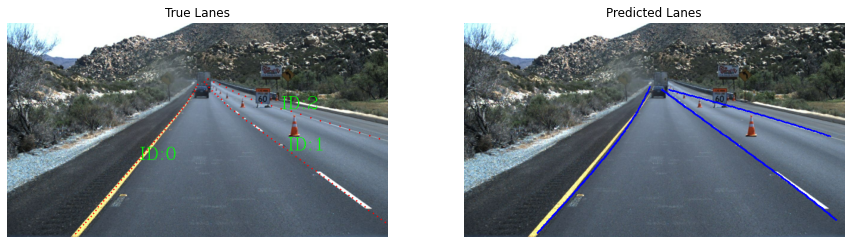

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0058823535 1.0
image size: [360, 640]


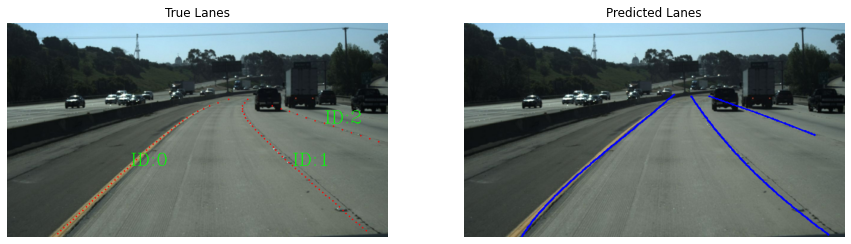

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.014705883 1.0
image size: [360, 640]


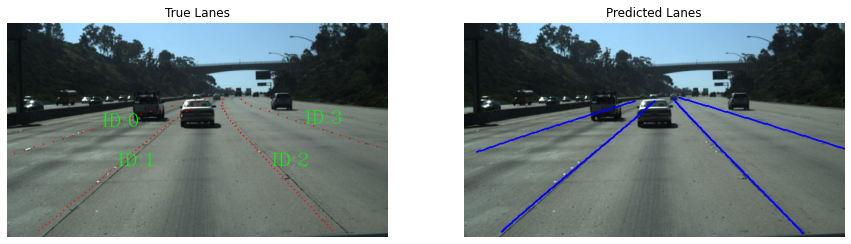

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


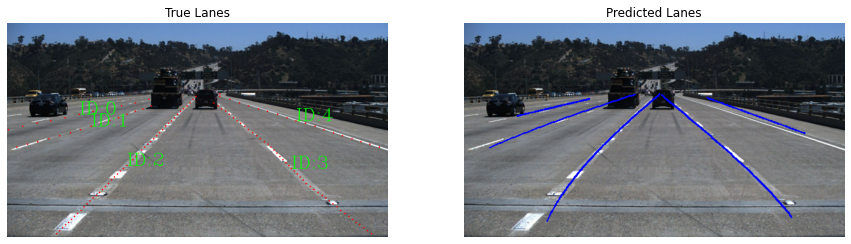

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


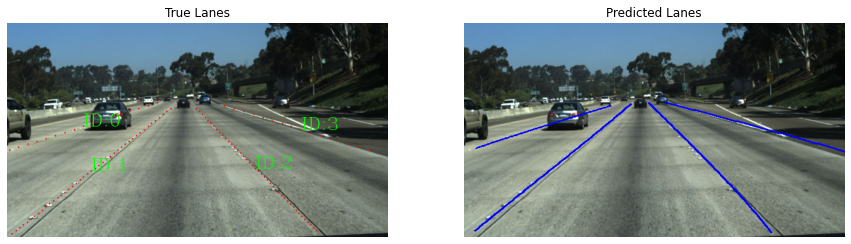

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.025490198 1.0
image size: [360, 640]


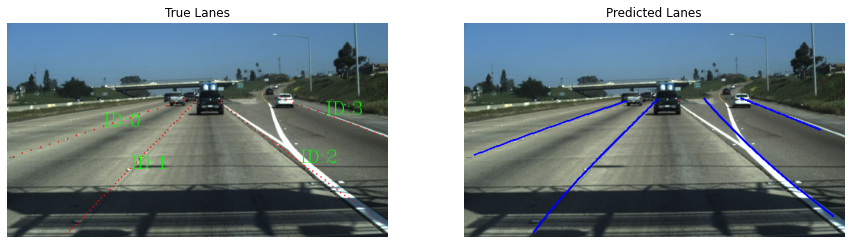

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


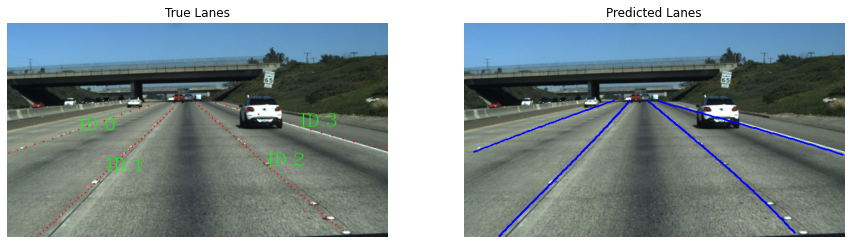

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 0.99313724
image size: [360, 640]


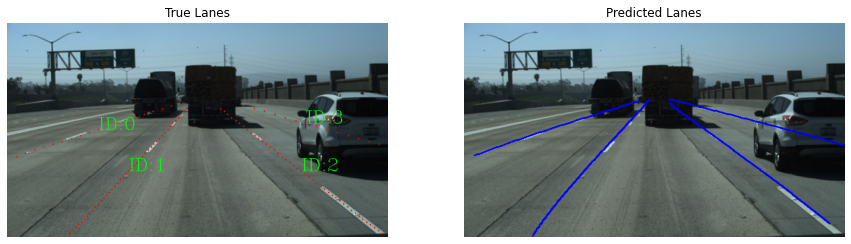

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.01764706 1.0
image size: [360, 640]


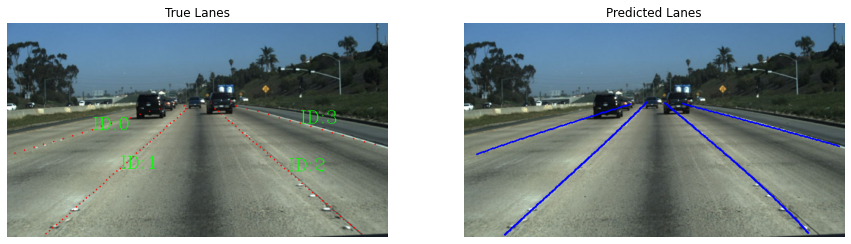

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


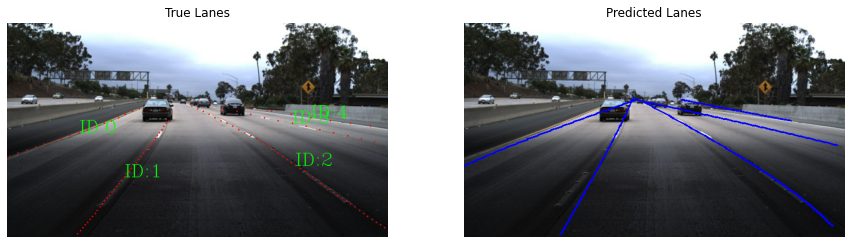

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0019607844 1.0
image size: [360, 640]


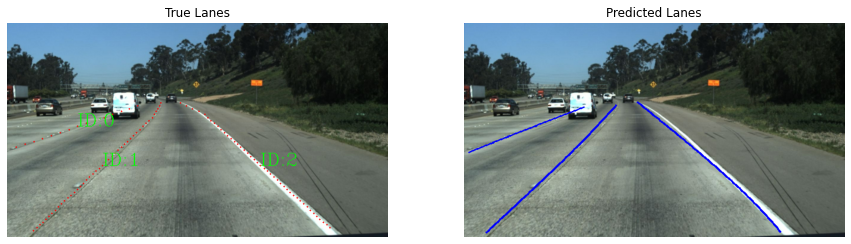

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.012745099 1.0
image size: [360, 640]


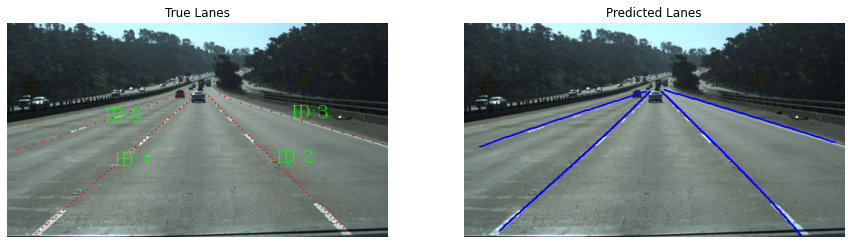

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


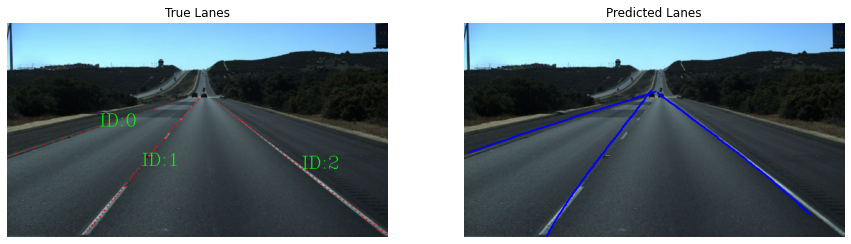

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0058823535 1.0
image size: [360, 640]


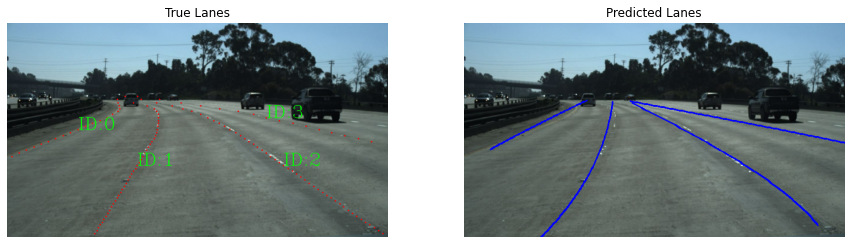

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0009803922 1.0
image size: [360, 640]


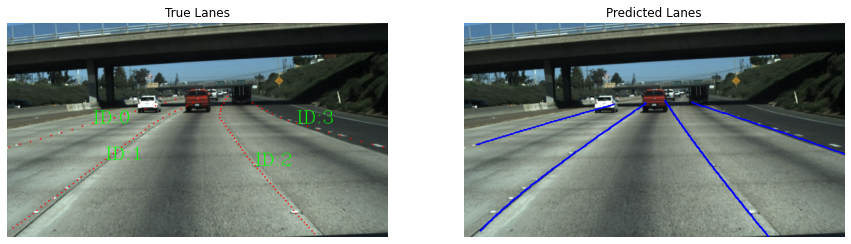

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0068627456 1.0
image size: [360, 640]


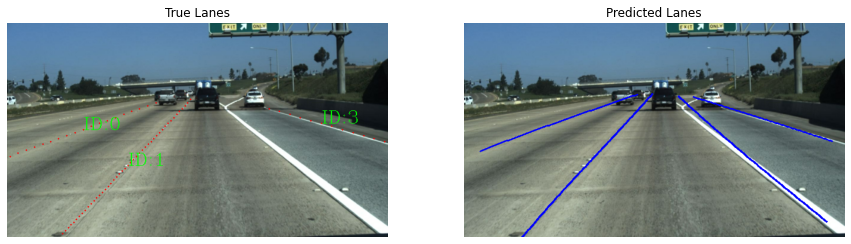

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.01764706 1.0
image size: [360, 640]


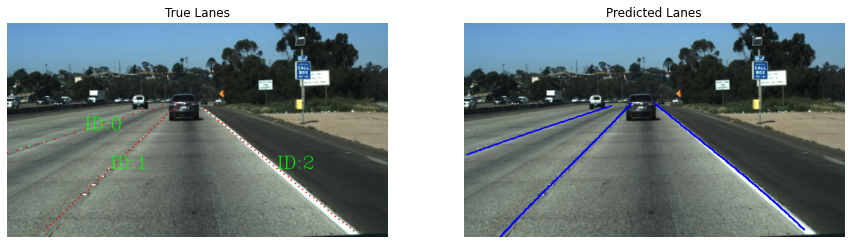

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


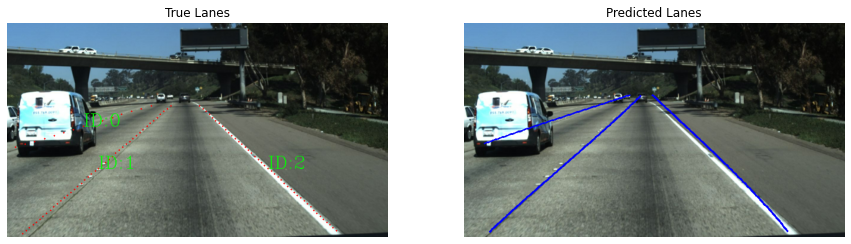

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


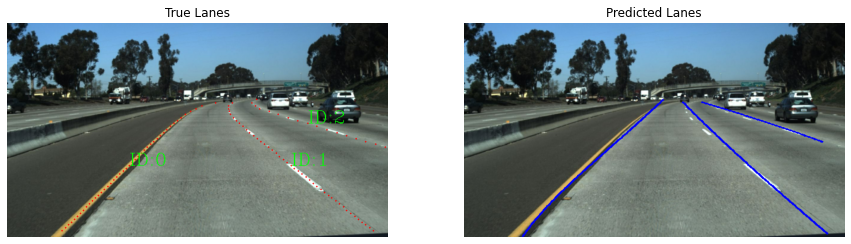

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


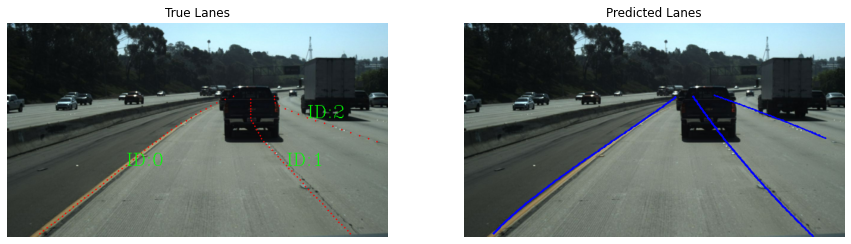

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


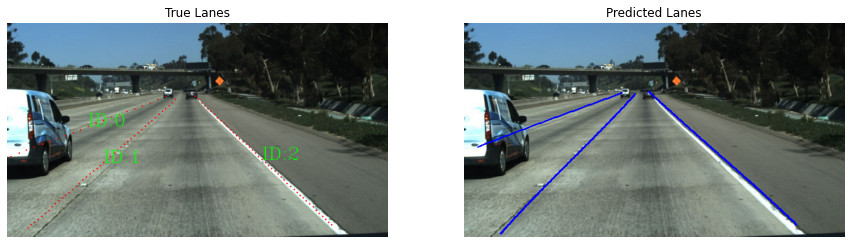

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


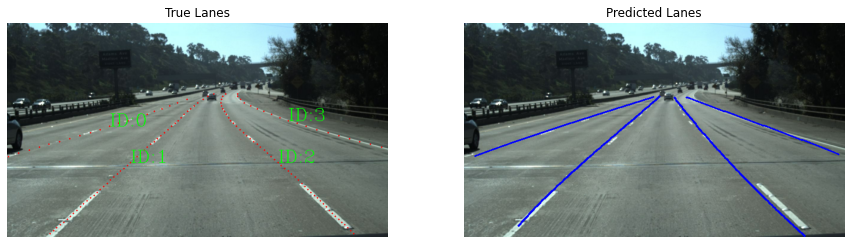

Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


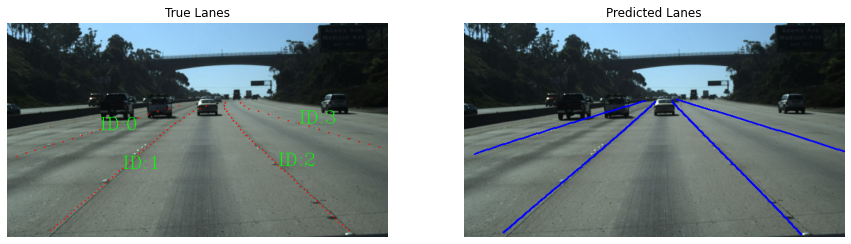

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


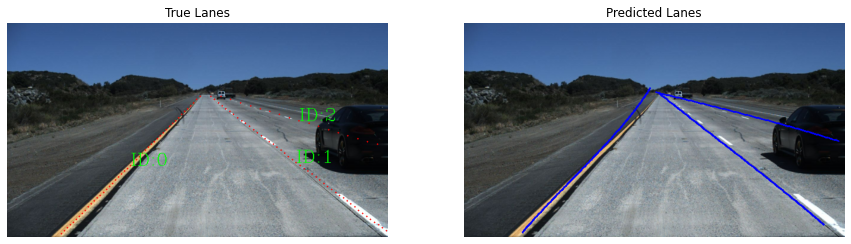

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


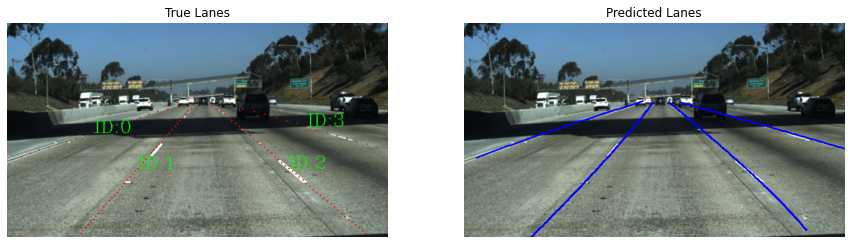

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


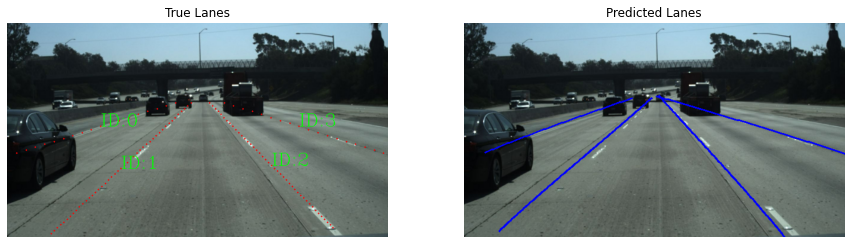

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


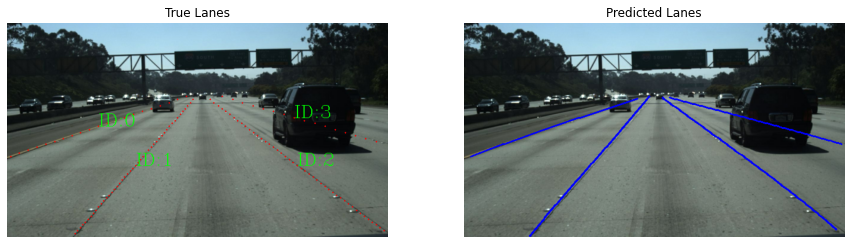

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.017647061 1.0
image size: [360, 640]


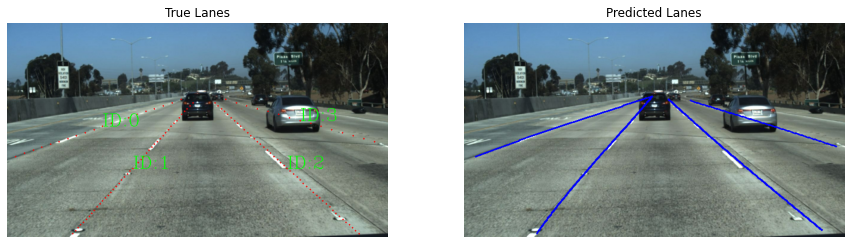

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0009803922 1.0
image size: [360, 640]


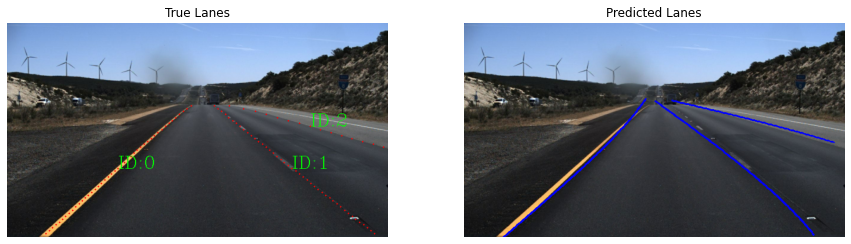

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


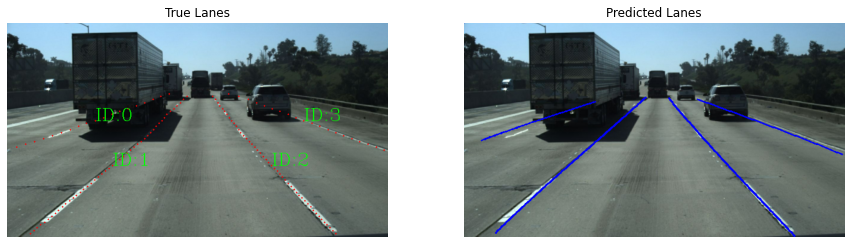

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0019607844 1.0
image size: [360, 640]


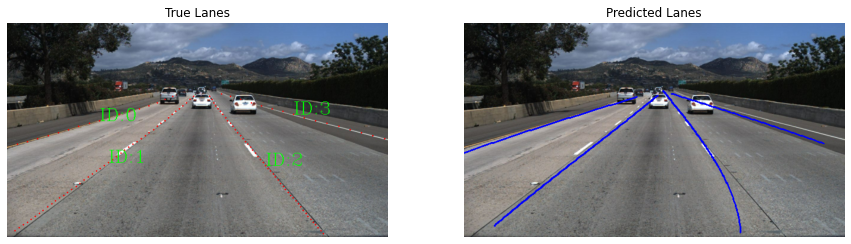

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0019607844 1.0
image size: [360, 640]


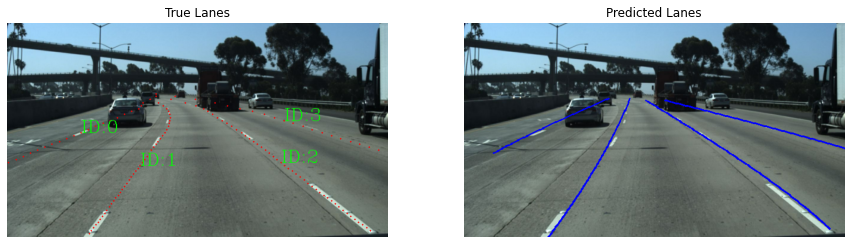

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0058823535 1.0
image size: [360, 640]


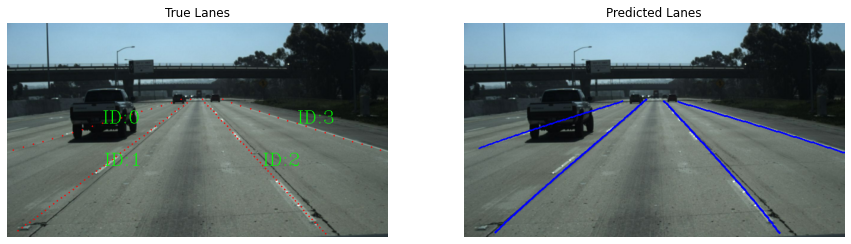

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0019607844 1.0
image size: [360, 640]


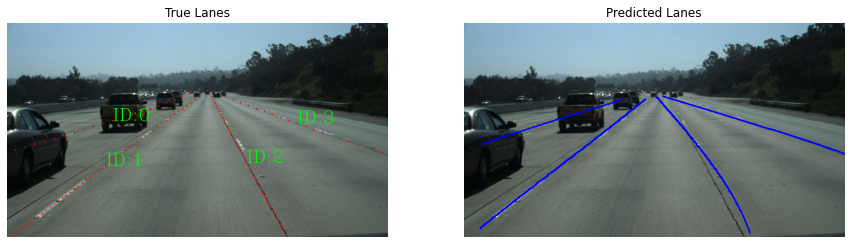

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


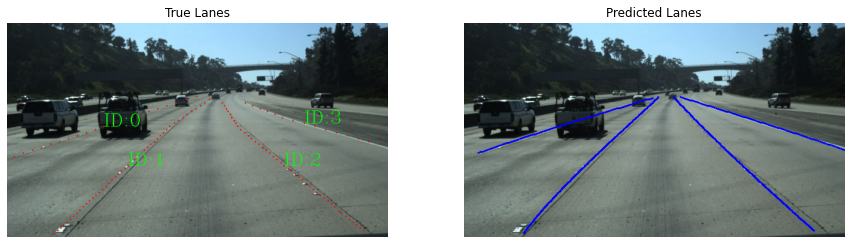

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


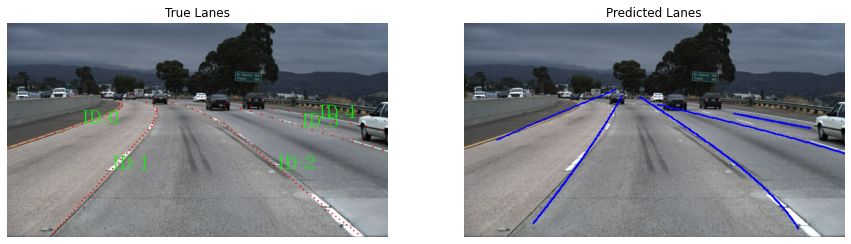

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


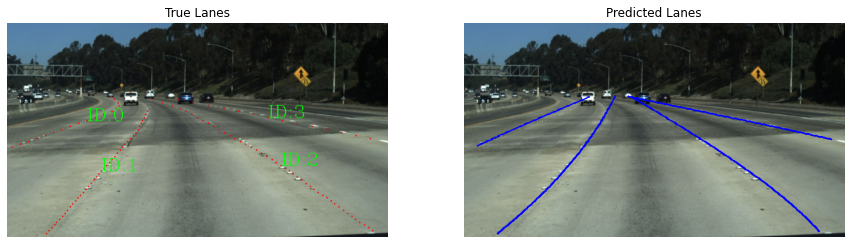

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


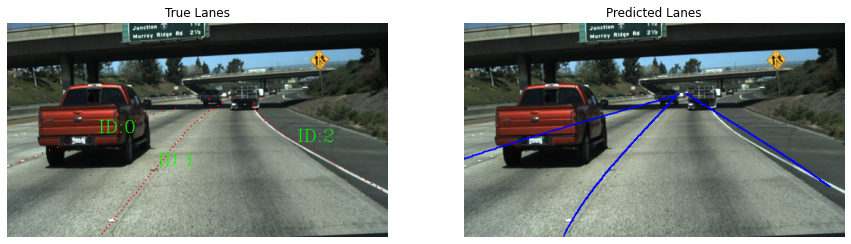

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


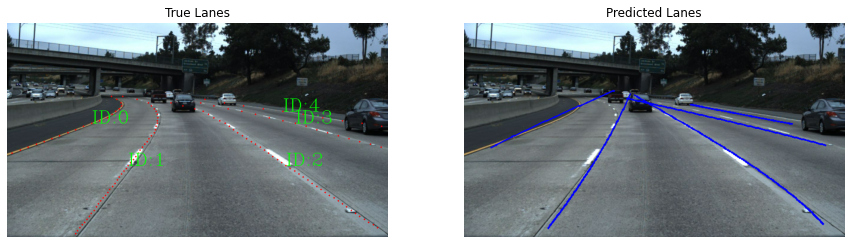

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 0.8980393
image size: [360, 640]


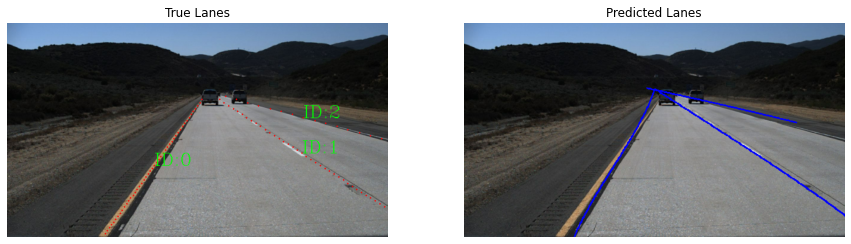

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


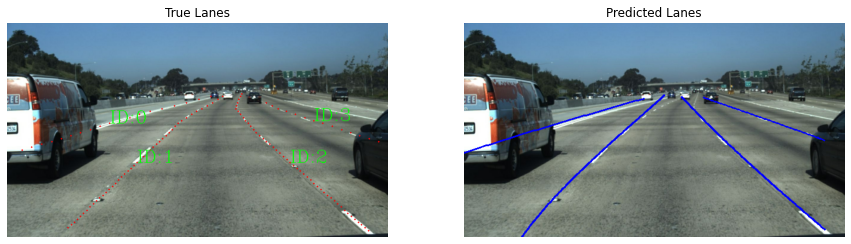

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.008823531 1.0
image size: [360, 640]


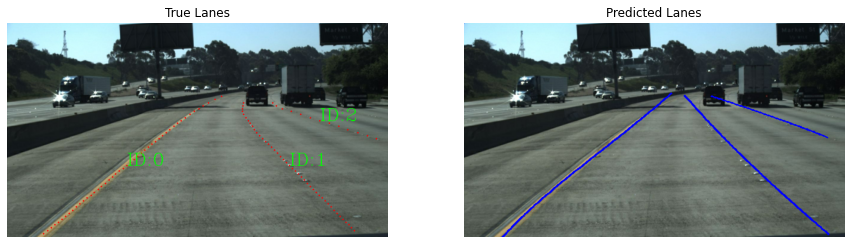

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


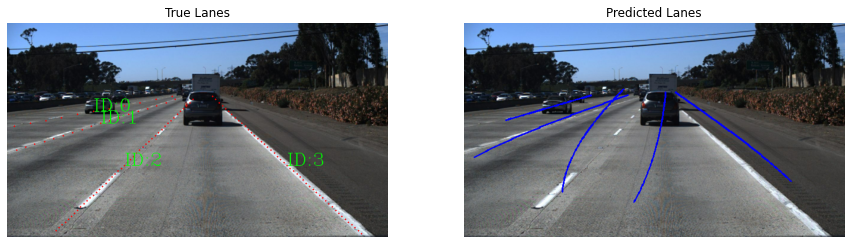

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


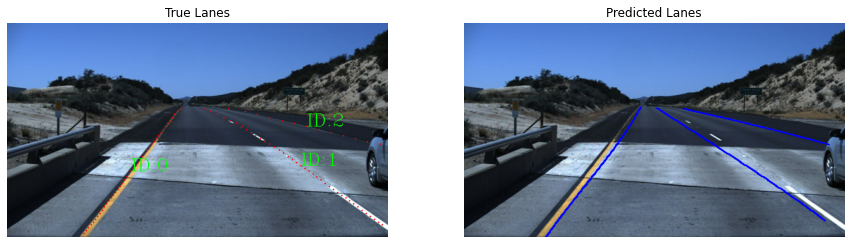

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


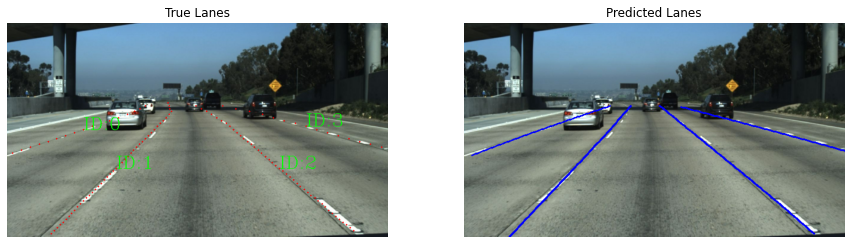

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0058823535 1.0
image size: [360, 640]


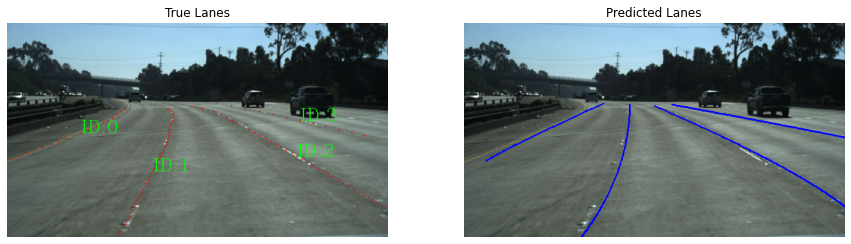

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0009803922 1.0
image size: [360, 640]


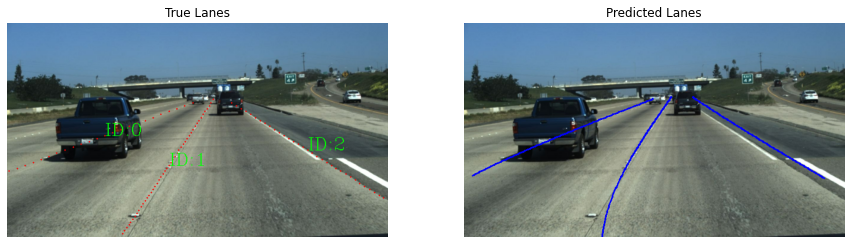

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


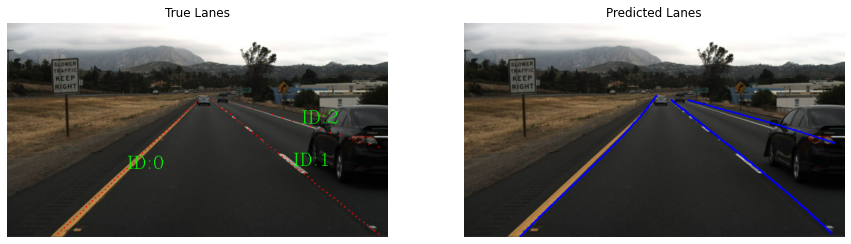

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


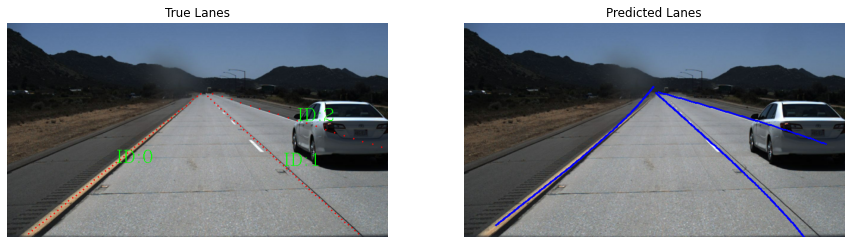

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


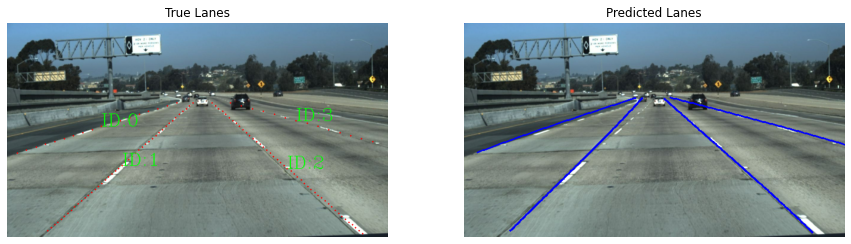

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0068627456 1.0
image size: [360, 640]


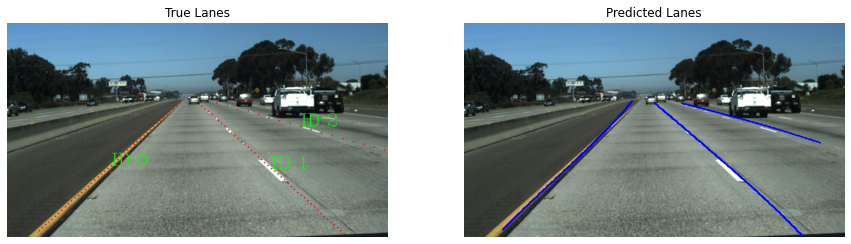

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0019607844 1.0
image size: [360, 640]


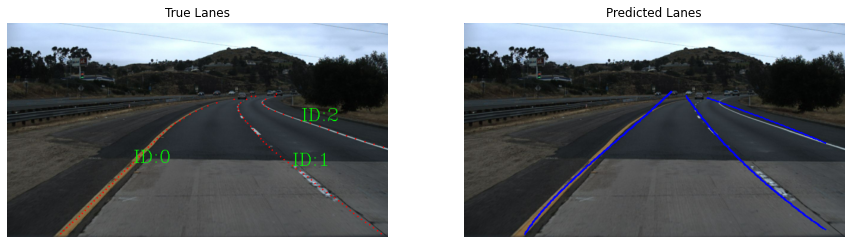

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


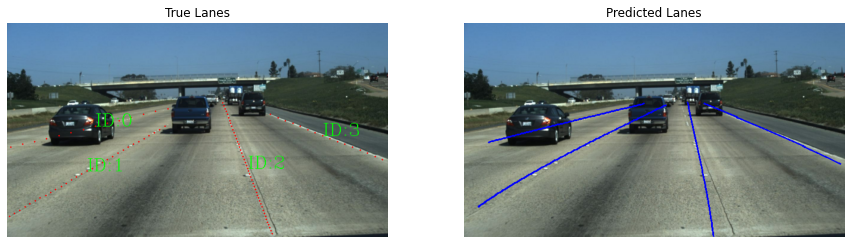

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


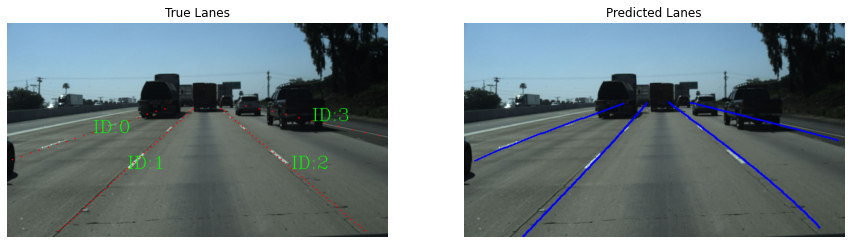

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


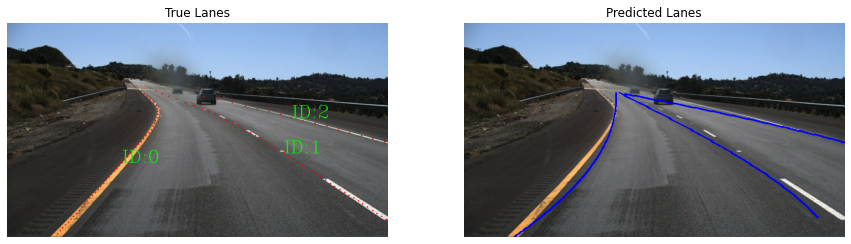

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


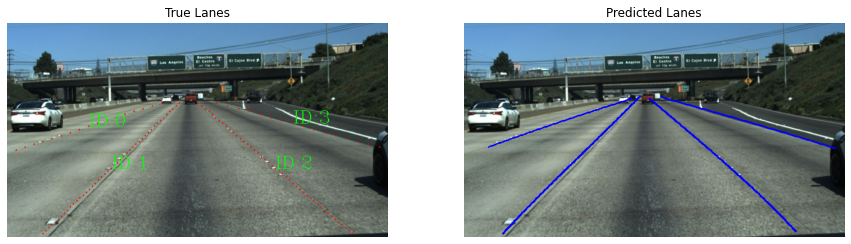

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0049019614 1.0
image size: [360, 640]


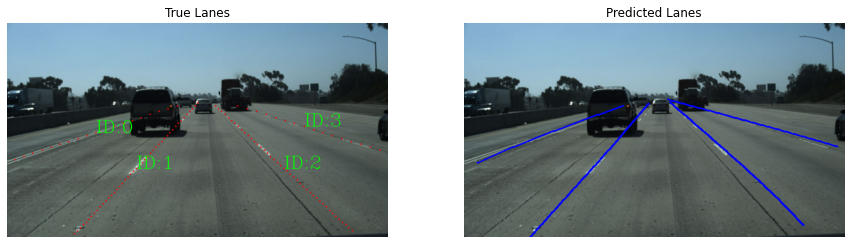

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0009803922 1.0
image size: [360, 640]


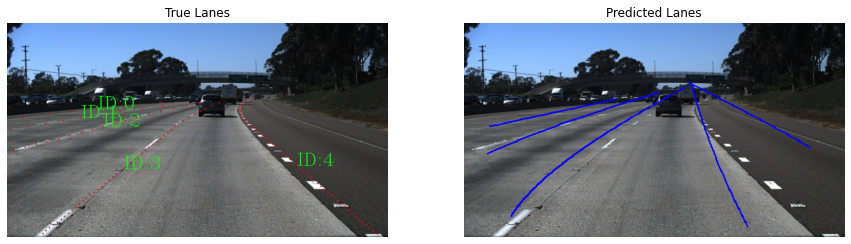

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


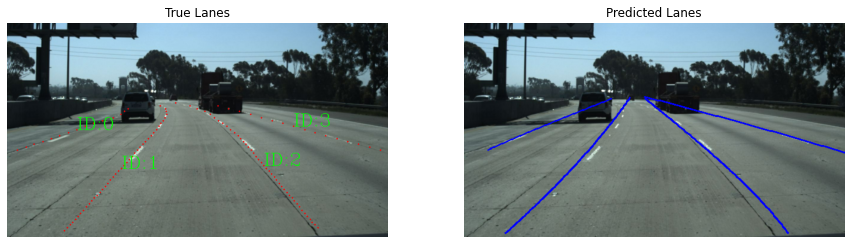

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.028431375 1.0
image size: [360, 640]


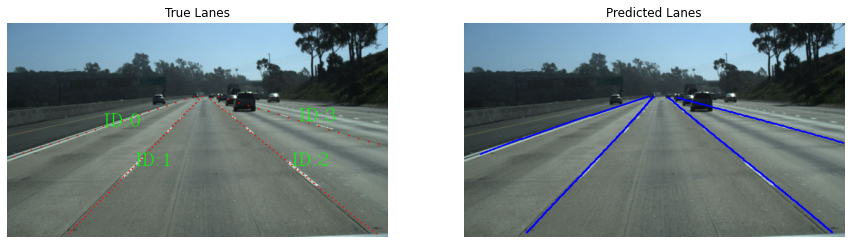

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0068627456 1.0
image size: [360, 640]


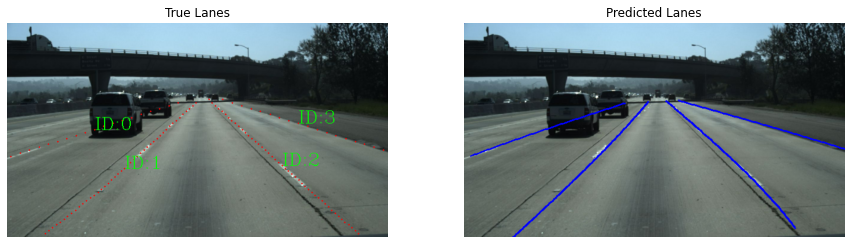

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.003921569 1.0
image size: [360, 640]


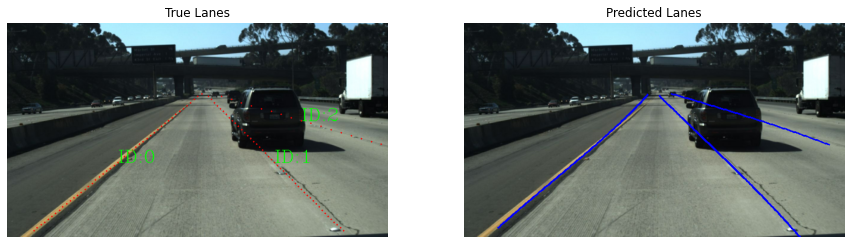

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.003921569 1.0
image size: [360, 640]


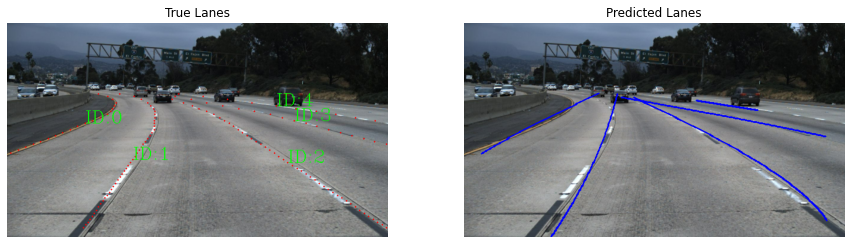

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


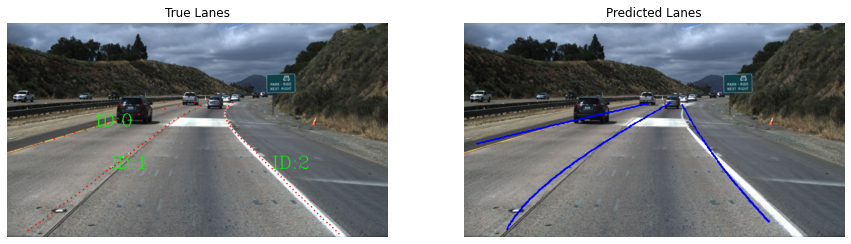

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


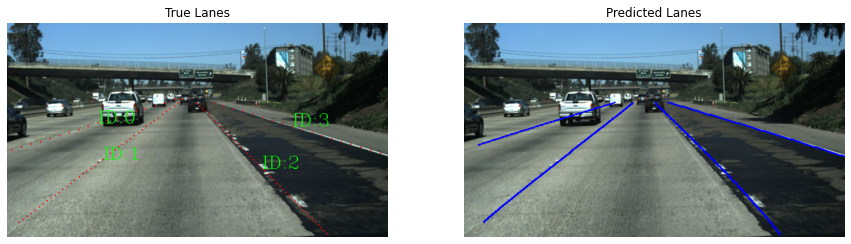

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


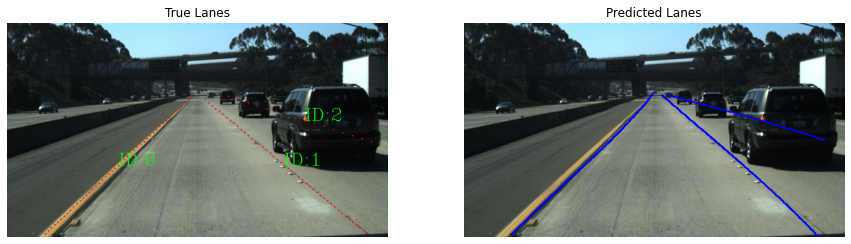

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0 1.0
image size: [360, 640]


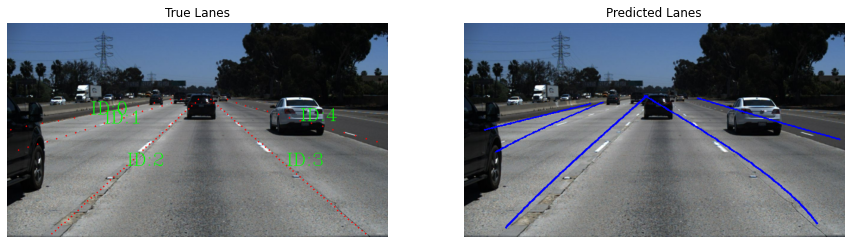

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.0029411768 1.0
image size: [360, 640]


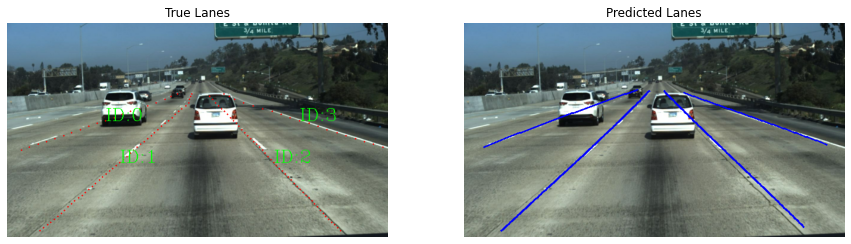

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.008823531 1.0
image size: [360, 640]


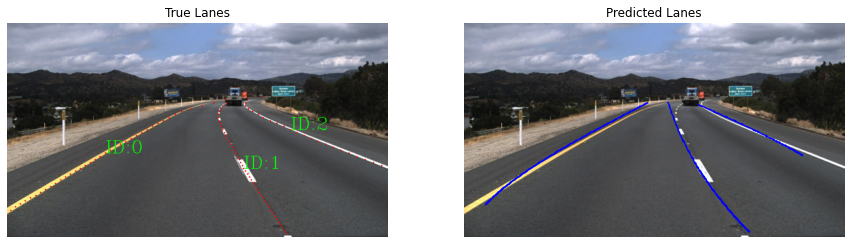

Min and max pixel values: 0.007843138 1.0
image size: [360, 640]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


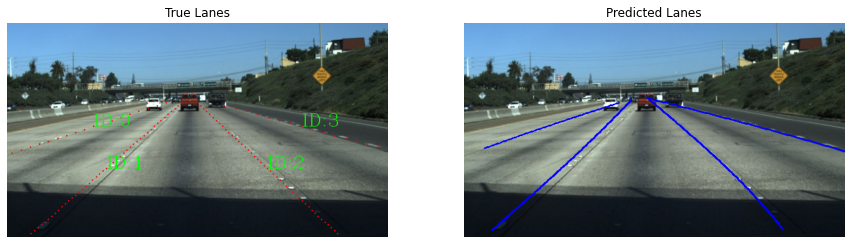

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Min and max pixel values: 0.008823531 1.0
image size: [360, 640]


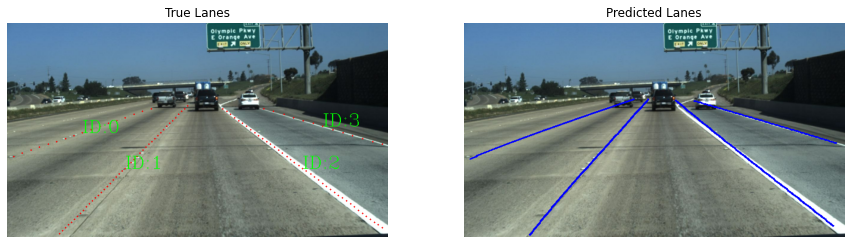

In [ ]:
def decode_label(predicted_label, threshold = 0.5):

  def sig(value):
    return activations.sigmoid(value)
  
  # score + upper + lower + 4 coeffs = 7
  predicted_label = predicted_label.reshape(len(predicted_label), -1, 7) 
  predicted_label[:, :, 0] = sig(predicted_label[:, :, 0])
  predicted_label[predicted_label[:, :, 0] < threshold] = 0
  return predicted_label

for next_element in valds.take(5):

  batch_of_imgs, label = next_element
  predicted_label = LaneModel.predict(batch_of_imgs)
  for i in range(batch_size):
    img = draw_truelabel(batch_of_imgs[i], label[i], True)
    decoded_label = decode_label(predicted_label)
    img_pre = draw_prediction(batch_of_imgs[i], decoded_label[i], True)
    display([img, img_pre])